In [63]:
import os
import sys
import pandas as pd
import numpy as np
import glob
import time
import gget
import scipy
import matplotlib.patches as patches
from scipy.sparse import csr_matrix
import anndata as an
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import math
import matplotlib.patches as mpatches
import matplotlib.cm as cm
from pycirclize import Circos
from scipy.interpolate import splprep, splev
import networkx as nx
import random
from importlib import reload
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import MultiLabelBinarizer
import warnings
from itertools import combinations
import ot
from scipy.spatial.distance import pdist, squareform
from matplotlib.colors import ListedColormap

import surprise as sup

from sklearn.decomposition import TruncatedSVD
from sklearn.preprocessing import MinMaxScaler

"""WARNING: no warnings"""
warnings.filterwarnings("ignore")

# local imports
import anndata_utils as anntools

source_path = os.path.abspath("../source/")
sys.path.append(source_path)
import centrality as central
import matrix
import utils as ut
import plotting as plt2

# Load the data 

In [2]:
# load ann data
resolution = 1000000
population_path = f"/scratch/indikar_root/indikar1/shared_data/higher_order/lightweight/population_mESC_{resolution}_anndata.h5ad"

start_time = time.time()  # Record the start time
adata = sc.read_h5ad(population_path)
end_time = time.time()  # Record the end time
print(f"Time taken to read the file: {end_time - start_time:.2f} seconds")
sc.logging.print_memory_usage()

# sort the object by global bin id
sorted_indices = adata.obs['bin'].argsort()
adata = adata[sorted_indices, :] 

adata.uns['chrom_sizes']['n_bins'] = adata.uns['chrom_sizes']['size'] // adata.uns['base_resolution']
adata.uns['chrom_sizes'].head()

adata

Time taken to read the file: 12.06 seconds
Memory usage: current 1.53 GB, difference +1.53 GB


View of AnnData object with n_obs × n_vars = 2579 × 2756467
    obs: 'bin_index', 'bin_start', 'bin_end', 'bin', 'chrom', 'chrom_bin', 'degree', 'genes', 'n_genes', 'ATACSeq_1', 'ATACSeq_2', 'ATACSeq_3', 'CTCF', 'H3K27ac', 'H3K27me3', 'RNA_1', 'RNA_2', 'RNA_3', 'RNA_4', 'RNA_5', 'RNA_6'
    var: 'read_index', 'basename', 'mean_mapq', 'median_mapq', 'n_chromosomes', 'order', 'n_bins', 'read_length_bp', 'genes', 'n_genes'
    uns: 'base_resolution', 'chrom_sizes'

In [3]:
def find_outliers(df_column):
  """
  Identifies outliers in a pandas DataFrame column using the IQR method.

  Args:
    df_column: A pandas Series representing the column to analyze.

  Returns:
    A boolean mask with True for outliers and False otherwise.
  """
  Q1 = df_column.quantile(0.15)
  Q3 = df_column.quantile(0.85)
  IQR = Q3 - Q1
  lower_bound = Q1 - 1.5 * IQR
  upper_bound = Q3 + 1.5 * IQR
  return (df_column < lower_bound) | (df_column > upper_bound)

adata.obs['degree_outlier'] = find_outliers(adata.obs['degree'])

print(adata.obs['degree_outlier'].value_counts())

# remove outliers
remove_bins = adata.obs[adata.obs['degree_outlier']].index.to_list()
print(f"Removing top {len(remove_bins)} outlier loci: ")
print(remove_bins)

adata = adata[~adata.obs_names.isin(remove_bins), :].copy()

print('done!')

degree_outlier
False    2431
True      148
Name: count, dtype: int64
Removing top 148 outlier loci: 
['chr1:24', 'chr1:85', 'chr1:195', 'chr2:98', 'chr2:177', 'chr4:112', 'chr4:145', 'chr4:146', 'chr4:147', 'chr5:94', 'chr5:95', 'chr6:103', 'chr7:20', 'chr7:21', 'chr7:22', 'chr7:32', 'chr8:19', 'chr8:20', 'chr8:21', 'chr8:70', 'chr8:130', 'chr9:3', 'chr9:35', 'chr9:124', 'chr10:130', 'chr11:3', 'chr12:3', 'chr13:65', 'chr13:66', 'chr14:3', 'chr14:15', 'chr14:16', 'chr14:17', 'chr14:18', 'chr14:19', 'chr14:125', 'chr16:3', 'chr17:95', 'chr19:61', 'chrX:6', 'chrX:8', 'chrX:9', 'chrX:10', 'chrX:14', 'chrX:15', 'chrX:16', 'chrX:17', 'chrX:18', 'chrX:19', 'chrX:22', 'chrX:23', 'chrX:24', 'chrX:25', 'chrX:26', 'chrX:27', 'chrX:29', 'chrX:34', 'chrX:38', 'chrX:39', 'chrX:40', 'chrX:42', 'chrX:43', 'chrX:44', 'chrX:45', 'chrX:46', 'chrX:48', 'chrX:49', 'chrX:53', 'chrX:54', 'chrX:57', 'chrX:58', 'chrX:60', 'chrX:61', 'chrX:62', 'chrX:63', 'chrX:64', 'chrX:65', 'chrX:66', 'chrX:67', 'chrX:68', 

In [4]:
fpath = "/scratch/indikar_root/indikar1/shared_data/higher_order/global_core_score/population_mESC_1000000_scores.csv"
df = pd.read_csv(fpath)
print(f"{df.shape=}")

columns_to_drop = [x for x in df.columns if x in adata.obs.columns]
df = df.drop(columns=columns_to_drop)
print(f"{df.shape=}")

adata.obs = pd.merge(
    adata.obs, df.set_index('bin_name'),
    how='left',
    left_index=True,
    right_index=True,
)

adata.obs.head()


df.shape=(2431, 36)
df.shape=(2431, 14)


,bin_index,bin_start,bin_end,bin,chrom,chrom_bin,degree,genes,n_genes,ATACSeq_1,...,ce_betweenness_centrality,ce_pagerank,hge_singular_vector_1,hge_logexp_unweighted,hge_logexp_degree_weighted,hge_logexp_RNA_weighted,hge_logexp_ATAC_weighted,global_singular_vector_1,global_hge_logexp_unweighted,global_hge_logexp_RNA_weighted
bin_name,,,,,,,,,,,,,,,,,,,,,
chr1:3,2235,3000000,4000000,3,1,3,2953,Gm37363;Gm37381;Gm7341;Gm38148;Gm37180;Gm19938...,15,0.507852,...,0.671480,0.117995,0.000000,0.148099,0.000000,0.174370,0.222380,0.330855,0.501567,0.167764
chr1:4,964,4000000,5000000,4,1,4,3331,Gm7369;A930006A01Rik;Gm37381;Gm38076;Mrpl15;Gm...,22,0.680719,...,0.267148,0.372869,0.103845,0.239187,0.281148,0.468270,0.560302,0.412235,0.609261,0.369136
chr1:5,1823,5000000,6000000,5,1,5,3341,Atp6v1h;Gm17101;Gm16041;Rgs20;Gm36965;Gm38264;...,12,0.567134,...,0.109507,0.224249,0.057865,0.647027,0.201096,0.243125,0.405148,0.425601,0.528269,0.216383
chr1:6,1288,6000000,7000000,6,1,6,3422,St18;Gm7449;Gm19214;Gm37108;Gm2147;Gm19026;473...,10,0.621495,...,0.009627,0.534940,0.172229,0.760979,0.401754,0.250762,0.521777,0.448264,0.492633,0.258762
chr1:7,144,7000000,8000000,7,1,7,3289,Gm23274;Gm5694;Rps2-ps2;Gm37225;Gm37489;Gm2690...,18,0.497991,...,0.252708,0.099600,0.053319,0.000000,0.160235,0.190846,0.204818,0.414267,0.510526,0.204855


# Define the core

In [5]:
order_threshold = 3
score_column = 'global_hge_logexp_RNA_weighted'
core_threshold_quantile = 0.75
threshold = np.quantile(adata.obs[score_column], core_threshold_quantile)

print(f"Using score column: {score_column}")
print(f"Core threshold quantile: {core_threshold_quantile}")
print(f"Calculated threshold: {threshold:.3f}") 

core_nodes = adata.obs[adata.obs[score_column] > threshold].index.to_list()

print(f"Detected {(len(core_nodes))} of {len(adata.obs)} total nodes ({100*((len(core_nodes)) / len(adata.obs)):.1f}%)")

# extract the core from population
core = adata[core_nodes, :].copy()
core = core[:, core.X.sum(axis=0) > order_threshold].copy()

core

Using score column: global_hge_logexp_RNA_weighted
Core threshold quantile: 0.75
Calculated threshold: 0.352
Detected 608 of 2431 total nodes (25.0%)


AnnData object with n_obs × n_vars = 608 × 47800
    obs: 'bin_index', 'bin_start', 'bin_end', 'bin', 'chrom', 'chrom_bin', 'degree', 'genes', 'n_genes', 'ATACSeq_1', 'ATACSeq_2', 'ATACSeq_3', 'CTCF', 'H3K27ac', 'H3K27me3', 'RNA_1', 'RNA_2', 'RNA_3', 'RNA_4', 'RNA_5', 'RNA_6', 'degree_outlier', 'chrom_degree', 'ce_singular_vector_1', 'ce_eigenvector_centrality', 'ce_betweenness_centrality', 'ce_pagerank', 'hge_singular_vector_1', 'hge_logexp_unweighted', 'hge_logexp_degree_weighted', 'hge_logexp_RNA_weighted', 'hge_logexp_ATAC_weighted', 'global_singular_vector_1', 'global_hge_logexp_unweighted', 'global_hge_logexp_RNA_weighted'
    var: 'read_index', 'basename', 'mean_mapq', 'median_mapq', 'n_chromosomes', 'order', 'n_bins', 'read_length_bp', 'genes', 'n_genes'
    uns: 'base_resolution', 'chrom_sizes'

# Load the factories

In [6]:
def make_gene_adata(df):
    # Add index identifiers
    df['read_index'] = pd.factorize(df['read_name'])[0]
    df['gene_index'] = pd.factorize(df['gene_name'])[0]
    df['val'] = 1
    
    data = df['val'].tolist()
    row = df['gene_index'].values
    col = df['read_index'].values
    
    n = df['gene_index'].nunique()
    m = df['read_index'].nunique()

    obs_names = df['gene_name'].unique()
    var_names = df['read_name'].unique()

    X = csr_matrix((data, (row, col)), shape=(n, m))
    X = csr_matrix((X > 0).astype(int))

    gdata = an.AnnData(X=X)
    gdata.obs_names = obs_names
    gdata.var_names = var_names    
    return gdata

In [7]:
fpath = "/nfs/turbo/umms-indikar/shared/projects/twin_cell/data/b_matrix/SCENIC/scenic/tf_lists/allTFs_mm.txt"

tf_list = [x.strip() for x in open(fpath)]
print(f"(raw) {len(tf_list)=}")

# load genes
fpath = f"/scratch/indikar_root/indikar1/shared_data/higher_order/lightweight/population_mESC_{resolution}_gdf.parquet"
df = pd.read_parquet(fpath)
df['is_tf'] = df['gene_name'].isin(tf_list)
df['is_core'] = df['bin_name'].isin(core.obs_names)
print(f"{df.shape=}")
df.head()

(raw) len(tf_list)=1860
df.shape=(4939267, 6)


,gene_name,gene_biotype,read_name,bin_name,is_tf,is_core
0,Ulk4,protein_coding,3891ee6d-53d1-4ee0-ba2f-3d22291d4493,chr9:121,False,False
1,Smarca2,protein_coding,66953ddf-e76d-4cdf-aaf8-be028a2d7b04,chr19:26,False,False
2,Dlgap3,protein_coding,ad5b2240-893f-4ed0-a157-c2be66d8d754,chr4:127,False,True
3,Gm56531,lncRNA,3f354c45-5e48-4f6d-8c7e-05369432b344,chr12:8,False,False
4,Twsg1,protein_coding,d4626feb-16a2-4aac-8145-53e89b60bf7c,chr17:66,False,False


In [8]:
gdata = make_gene_adata(df)

# add obs
obs = df.copy()
obs = obs.sort_values(by=['gene_name', 'is_core'], ascending=[False, False])
obs = obs.drop_duplicates(subset=['gene_name'])
obs = obs.set_index('gene_name')

obs = obs.reindex(gdata.obs_names)

gdata.obs = obs
gdata.obs['chrom'] = gdata.obs['bin_name'].str.split(":").str[0]
gdata.obs['chrom_bin'] = gdata.obs['bin_name'].str.split(":").str[1]

gdata.obsm['A'] = gdata.X @ gdata.X.T 
gdata.obsm['A'] = pd.DataFrame.sparse.from_spmatrix(
    gdata.obsm['A'],
    index=gdata.obs_names,
    columns=gdata.obs_names,
)

gdata

AnnData object with n_obs × n_vars = 47286 × 2200583
    obs: 'gene_biotype', 'read_name', 'bin_name', 'is_tf', 'is_core', 'read_index', 'gene_index', 'val', 'chrom', 'chrom_bin'
    obsm: 'A'

# Genome-wide TFs

In [9]:
query = 'Foxp1'
df[df['gene_name'] == query]

,gene_name,gene_biotype,read_name,bin_name,is_tf,is_core,read_index,gene_index,val
2348,Foxp1,protein_coding,ebf68420-346f-48d8-8245-0b138f19bdee,chr6:98,True,False,2345,1571,1
5469,Foxp1,protein_coding,547dca50-bc0f-4ac0-862e-42d6358e3fe3,chr6:99,True,False,5455,1571,1
5938,Foxp1,protein_coding,481fbfcd-cb5d-4e78-be74-f7ac59b1fc82,chr6:99,True,False,5920,1571,1
5939,Foxp1,protein_coding,1c7882c9-832b-45e2-8d85-83c3fb9baec0,chr6:99,True,False,5921,1571,1
6017,Foxp1,protein_coding,9c677fc1-855b-4f8b-a49f-54f74580908b,chr6:99,True,False,5999,1571,1
...,...,...,...,...,...,...,...,...,...
4932283,Foxp1,protein_coding,b2829612-d88e-4674-b337-2cb8ecfbc793,chr6:98,True,False,1747938,1571,1
4936559,Foxp1,protein_coding,2a3a0cc8-900b-41f2-b862-226271aceb14,chr6:99,True,False,1915959,1571,1
4936794,Foxp1,protein_coding,a5409a78-f7b6-47f2-8bf4-c02f0d0e5dd1,chr6:99,True,False,412256,1571,1
4936796,Foxp1,protein_coding,1afcf10f-ba09-4a7e-af8b-bbdee21d047c,chr6:99,True,False,2077854,1571,1


# Summary

In [10]:
def load_pathway(fpath):
    """
    Loads an Enrichr-like database file into a boolean DataFrame.

    Args:
        fpath (str): Path to the Enrichr-like database file.

    Returns:
        pandas.DataFrame: A boolean DataFrame where:
            - Index: Genes
            - Columns: Pathways
            - Values: True if the gene is in the pathway, False otherwise.
    """

    result = []
    with open(fpath,  encoding='utf-8') as f:
        for line in f:
            split_line = [x for x in line.strip().split('\t') if x]  # Remove empty strings directly

            row = {'label': split_line[0]}
            for gene in split_line[1:]:
                row[gene] = 1

            result.append(row)

    df = pd.DataFrame(result)
    df = df.fillna(0.0).set_index('label').astype(bool).T  # Chained operations for clarity

    return df

fpath = "../../ONT-single-cell/resources/PanglaoDB_Augmented_2021.txt"
pdf = load_pathway(fpath)
stem_genes = list(pdf[pdf['Embryonic Stem Cells']].index)
stem_genes = [x.title() for x in stem_genes]
stem_genes[:10]

['Gjb1',
 'Amotl2',
 'Yap1',
 'Fbln1',
 'Uaca',
 'Antxr1',
 'Fermt2',
 'Serpinh1',
 'Pls3',
 'Gpx8']

In [11]:
# all gene stats
pdf = df.copy()
pdf['chrom'] = pdf['bin_name'].str.split(":").str[0]
pdf['is_pt'] = pdf['gene_biotype'] == 'protein_coding'

pdf = pdf.groupby([
    'gene_name',
    'gene_biotype', 
    'chrom', 
    'is_tf',
    'is_core',
    'is_pt'])['read_name'].nunique().reset_index()


pdf = pdf.sort_values(by='read_name', ascending=False)
pdf['is_marker'] = pdf['gene_name'].isin(stem_genes)

print(f"{pdf.shape=}")

# for c in ['gene_biotype', 'chrom', 'is_tf', 'is_core']:
#     print(f"\n-- {c} --")
#     print(pdf[c].value_counts())

pdf.head()

pdf.shape=(47826, 8)


,gene_name,gene_biotype,chrom,is_tf,is_core,is_pt,read_name,is_marker
5844,Chl1,protein_coding,chr6,False,False,True,45711,False
18683,Gm33838,lncRNA,chr9,False,False,False,14426,False
8997,Fgfr2,protein_coding,chr7,False,False,True,8518,False
6207,Cntnap2,protein_coding,chr6,False,False,True,7258,False
40214,Ptprd,protein_coding,chr4,False,False,True,6639,False


In [12]:
print(pdf[(pdf['chrom'] == 'chr11') & (pdf['is_tf'])].head(10).to_latex())

\begin{tabular}{llllrrrrr}
\toprule
 & gene_name & gene_biotype & chrom & is_tf & is_core & is_pt & read_name & is_marker \\
\midrule
7942 & Ebf1 & protein_coding & chr11 & True & False & True & 1548 & False \\
33330 & Kcnip1 & protein_coding & chr11 & True & True & True & 1442 & False \\
35584 & Msi2 & protein_coding & chr11 & True & True & True & 1405 & False \\
36192 & Nf1 & protein_coding & chr11 & True & True & True & 1031 & False \\
34858 & Meis1 & protein_coding & chr11 & True & False & True & 589 & False \\
36044 & Ncor1 & protein_coding & chr11 & True & True & True & 550 & False \\
47458 & Zfp652 & protein_coding & chr11 & True & True & True & 505 & False \\
4485 & Bptf & protein_coding & chr11 & True & True & True & 460 & False \\
32844 & Ikzf1 & protein_coding & chr11 & True & False & True & 374 & False \\
4298 & Bcl11a & protein_coding & chr11 & True & False & True & 362 & False \\
\bottomrule
\end{tabular}



In [13]:
def analyze_gene(df, query):
    """
    Analyzes gene expression data for a specific gene.

    Args:
      df: DataFrame containing gene expression data.
      query: The name of the gene to analyze.

    Returns:
      A dictionary containing various statistics about the gene.
    """

    query_reads = df[df['gene_name'] == query]['read_name'].unique()
    qdf = df[df['read_name'].isin(query_reads)].copy()
    qdf['is_pt'] = qdf['gene_biotype'] == 'protein_coding'
    
    global_order = np.mean(df['read_name'].value_counts())
    query_order = np.mean(qdf['read_name'].value_counts())

    stats = {
        'gene': query,
        'reads': len(query_reads),
        'global_order': global_order,
        'query_order': query_order,
        'order_ratio': query_order / global_order,
    }

    for c in ['is_pt', 'is_tf', 'is_core']:
        subset_order = np.mean(qdf[qdf[c]]['read_name'].value_counts())
        stats[f'{c}_order'] = subset_order
        stats[f'{c}_order_ratio'] = subset_order / global_order

    # Additional statistics
    stats['total_reads'] = len(df['read_name'].unique())
    stats['read_percentage'] = len(query_reads) / stats['total_reads'] * 100
    stats['pt_percentage'] = qdf['is_pt'].mean() * 100

    return stats

# Example usage
query = 'Sox5'
gene_stats = analyze_gene(df, query)

print(f"Analysis of gene: {gene_stats['gene']}")
print(f"  Detected in {gene_stats['reads']} reads ({gene_stats['read_percentage']:.2f}% of total reads)")
print(f"  Average order: {gene_stats['query_order']:.3f} (global: {gene_stats['global_order']:.3f}, ratio: {gene_stats['order_ratio']:.3f})")
print(f"  Protein-coding reads: {gene_stats['pt_percentage']:.2f}%")

for c in ['is_pt', 'is_tf', 'is_core']:
    print(f"  -- {c} order: {gene_stats[f'{c}_order']:.3f} (ratio: {gene_stats[f'{c}_order_ratio']:.3f})")

Analysis of gene: Sox5
  Detected in 3633 reads (0.17% of total reads)
  Average order: 3.220 (global: 2.245, ratio: 1.435)
  Protein-coding reads: 87.54%
  -- is_pt order: 2.819 (ratio: 1.256)
  -- is_tf order: 1.168 (ratio: 0.521)
  -- is_core order: 1.610 (ratio: 0.717)


# common partners

In [14]:
query = 'Zfhx3'

query_reads = df[df['gene_name'] == query]['read_name'].unique()
qdf = df[df['read_name'].isin(query_reads)].copy()
qdf = qdf[qdf['gene_name'] != query]

# Calculate value counts
counts = qdf['gene_name'].value_counts()

# Calculate normalized value counts
normalized_counts = qdf['gene_name'].value_counts(normalize=True)

# Combine counts and normalized counts into a single DataFrame
result = pd.DataFrame({'count': counts, 'normalized_count': normalized_counts})

# Display the top 10
print(result.head(10))

               count  normalized_count
gene_name                             
D030068K23Rik    130          0.014211
Chl1              71          0.007761
Cdh13             56          0.006122
Hydin             56          0.006122
Wwp2              46          0.005028
Wwox              42          0.004591
Pmfbp1            29          0.003170
Lncbate1          28          0.003061
Gm33838           19          0.002077
Tango6            18          0.001968


# circos

In [15]:
# tf = "Msi2"
tf = "Sox5"
order_threshold = 3
read_threshold = 2
pt_only = True
core_only = True

""" EXTRACT reads containing the gene of interest """
query_reads = df[df['gene_name'] == tf]['read_name'].unique()
print(f"detected {len(query_reads)} reds with {tf}")
query = df[df['read_name'].isin(query_reads)].copy()

""" FILTER reads and genes """
if pt_only:
    query = query[query['gene_biotype'] == 'protein_coding']

if core_only:
    query = query[query['is_core']]

query['reads_per_gene'] = query.groupby('gene_name')['read_name'].transform('nunique')
query = query[query['reads_per_gene'] >= read_threshold]

query['query_order'] = query.groupby('read_name')['gene_name'].transform('nunique')
query = query[query['query_order'] > order_threshold]
print(f"{query.shape[0]} pass filters ({query['gene_name'].nunique()} genes)")

""" SORT genes and chroms byu genomic position """
bin_map = dict(zip(adata.obs.index, adata.obs['bin']))
query['bin'] = query['bin_name'].map(bin_map)
query = query.sort_values(by='bin')

""" ADD metdata for the plot """
query['chrom'] = query['bin_name'].str.split(":").str[0]

print(f"{query.shape=}")

query.head()

detected 3633 reds with Sox5
51 pass filters (40 genes)
query.shape=(51, 13)


,gene_name,gene_biotype,read_name,bin_name,is_tf,is_core,read_index,gene_index,val,reads_per_gene,query_order,bin,chrom
1885217,Gm37988,protein_coding,e9336cd4-7f5e-4025-8ea0-c990891ec361,chr1:4,False,True,4458,12509,1,2,4,4,chr1
355801,Stau2,protein_coding,dbb00f02-da37-4bec-86c2-8745cf450c1f,chr1:16,True,True,326016,3609,1,3,4,16,chr1
4279177,Nhej1,protein_coding,ecf234e6-6b33-492c-b3db-37803d2bbeb0,chr1:75,False,True,376668,1195,1,2,4,75,chr1
2857545,Garnl3,protein_coding,37939b35-cbf0-4db3-96c1-5e465a18a6d9,chr2:32,False,True,608635,1136,1,2,4,228,chr2
4503996,Ubr1,protein_coding,4dbf3181-c92a-4fbb-ae30-493d0d352654,chr2:120,False,True,594270,7964,1,2,6,316,chr2


# base Circos plot

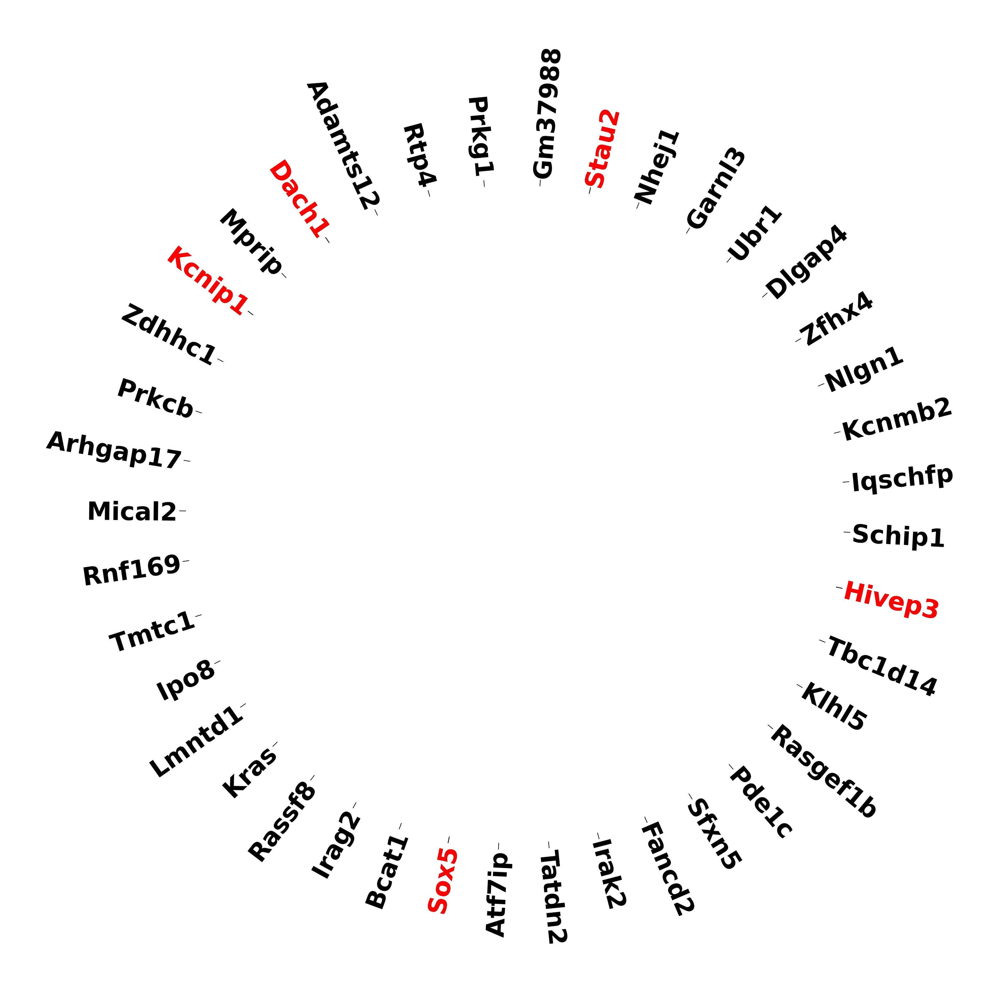

In [16]:
def plot_circos(ax, query, pad=0.25, fontsize=20, chrom_fontsize=18, label_chroms=True, 
                chrom_width=15, plot_chrom_blocks=True, label_genes=True, chrom_cmap='tab20c'):

    """ STRUCTURE the gene metadata """
    genes = query[['gene_name', 'is_tf', 'is_core', 'chrom', 'val']].drop_duplicates()
    genes['position'] = genes.groupby('chrom', sort=False).cumcount() + 0.5
    gene_dict = genes.set_index('gene_name').to_dict(orient='index')
    
    sectors = genes.groupby('chrom', sort=False)['gene_name'].count()

    """ ESTABLISH colors """
    chrom_colors = plt2.get_n_colors(
        len(sectors) + 2, 
        cmap_name=chrom_cmap,
    )
    
    chrom_colors = dict(zip(
        genes['chrom'].unique(),
        chrom_colors[1:-1]
    ))
    
    """ ADD chromosome track """
    circos = Circos(sectors, space=1.0)
    for i, sector in enumerate(circos.sectors):
    
        """ADD chromosome blocks """
        track = sector.add_track(name='chrom_block', r_lim=(100-chrom_width, 100))
        chrom = sector.name
        if plot_chrom_blocks:
            track.axis(
                fc=chrom_colors[chrom],
            )
        if label_chroms:
            track.text(
                chrom.replace("chr",""), 
                fontweight='bold',
                fontsize=chrom_fontsize,
                adjust_rotation=False,
            )

        if label_genes:
            chrom_data = genes[genes['chrom'] == chrom].reset_index()
    
            xticks = chrom_data['position'].values
            labels = chrom_data['gene_name'].values
        
            track.xticks(
                x = xticks,
                labels = labels,
                label_orientation='vertical',
                label_size=fontsize,
                text_kws={'color' : 'k', 'fontweight' : 'bold'},
            )
        
            # any TFs?
            tfs = chrom_data[chrom_data['is_tf']]
            if not tfs.empty:
                tf_indices = np.asarray(tfs.index)
                tf_labels = tfs['gene_name'].values
                tf_ticks = xticks[tf_indices]
                
                track.xticks(
                    x = tf_ticks,
                    labels = tf_labels,
                    label_orientation='vertical',
                    label_size=fontsize,
                    text_kws={'color' : 'r', 'fontweight' : 'bold'},
                )


    return circos, gene_dict

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 10, 10
fig = plt.figure()
ax = fig.add_subplot(111, polar=True)

circos, gene_dict = plot_circos(ax, query, pad=0.25, plot_chrom_blocks=False, label_chroms=False, chrom_cmap='tab20c')
    
fig = circos.plotfig(
    ax=ax,
)

In [17]:
# break

# Plot all interactions

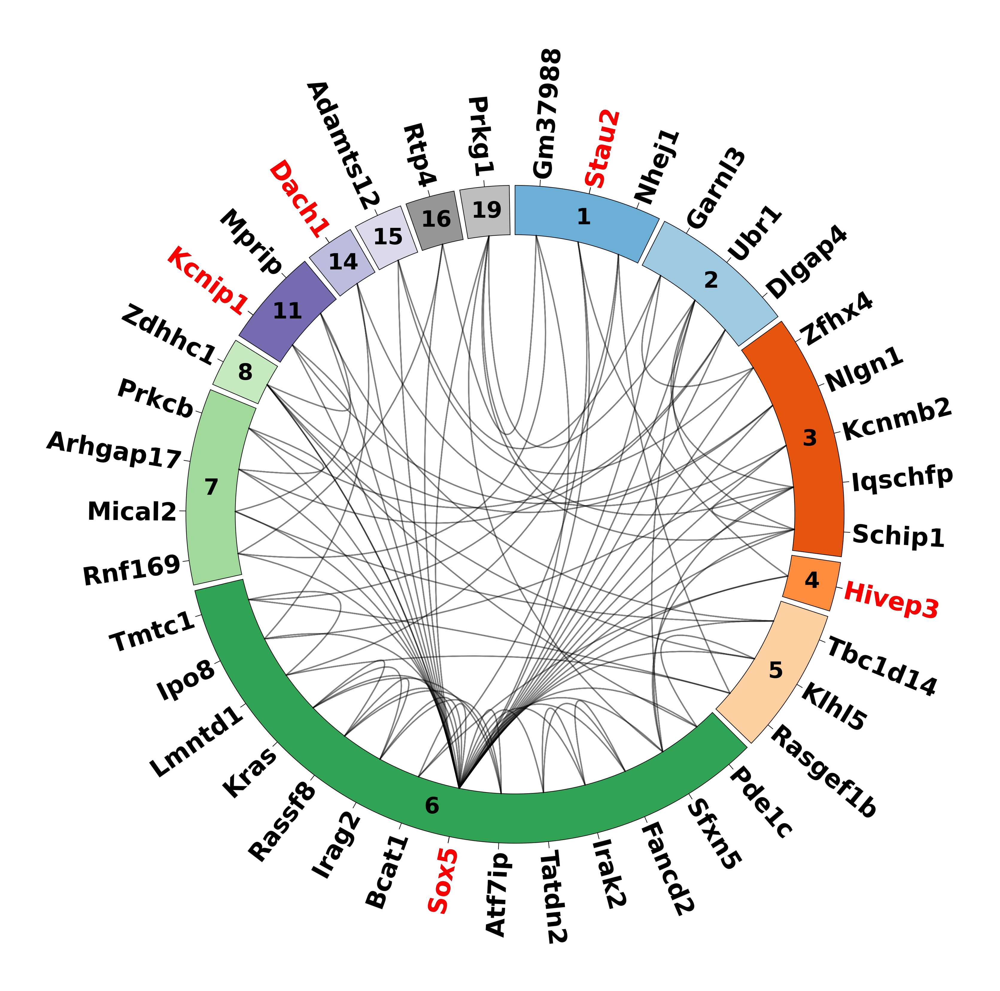

In [18]:
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 10, 10
fig = plt.figure()
ax = fig.add_subplot(111, polar=True)

circos, gene_dict = plot_circos(ax, query, pad=0.25, chrom_cmap='tab20c')

for read_name, group in query.groupby('read_name'):
    node_list = group['gene_name'].values
    pairs = list(combinations(node_list, 2))

    for i, j in pairs:
        circos.link(
            (gene_dict[i]['chrom'], gene_dict[i]['position'], gene_dict[i]['position']), 
            (gene_dict[j]['chrom'], gene_dict[j]['position'], gene_dict[j]['position']), 
            color='k',
            lw=1.0, 
            height_ratio=0.15,
            alpha=0.5, 
        )
        
fig = circos.plotfig(
    ax=ax,
)

In [19]:
# def get_pairs(query, normalize=True):
#     # get the total number of gene pairs each gene is involved in
#     H = pd.pivot_table(
#         query, 
#         index='read_name', 
#         columns='gene_name',
#         values='val',
#         fill_value=0.0
#     )
#     A = (H.T @ H)
#     np.fill_diagonal(A.to_numpy(), 0.0)
#     if normalize:
#         A = matrix.normalize_kr(A).todense()
#     A = pd.DataFrame(A, index=H.columns, columns=H.columns)
#     return A

# plt.rcParams['figure.dpi'] = 300
# plt.rcParams['figure.figsize'] = 10, 10
# fig = plt.figure()
# ax = fig.add_subplot(111, polar=True)

# line_scale = 10
# pair_counts = get_pairs(query)

# circos, gene_dict = plot_circos(ax, query, pad=0.25, chrom_cmap='tab20c')

# for read_name, group in query.groupby('read_name'):
#     node_list = group['gene_name'].values
#     pairs = list(combinations(node_list, 2))

#     for i, j in pairs:
#         lw  = pair_counts.loc[i, j] * line_scale
#         circos.link(
#             (gene_dict[i]['chrom'], gene_dict[i]['position'], gene_dict[i]['position']), 
#             (gene_dict[j]['chrom'], gene_dict[j]['position'], gene_dict[j]['position']), 
#             color='k',
#             lw=lw, 
#             height_ratio=0.15,
#             alpha=0.5, 
#         )
        
# fig = circos.plotfig(
#     ax=ax,
# )

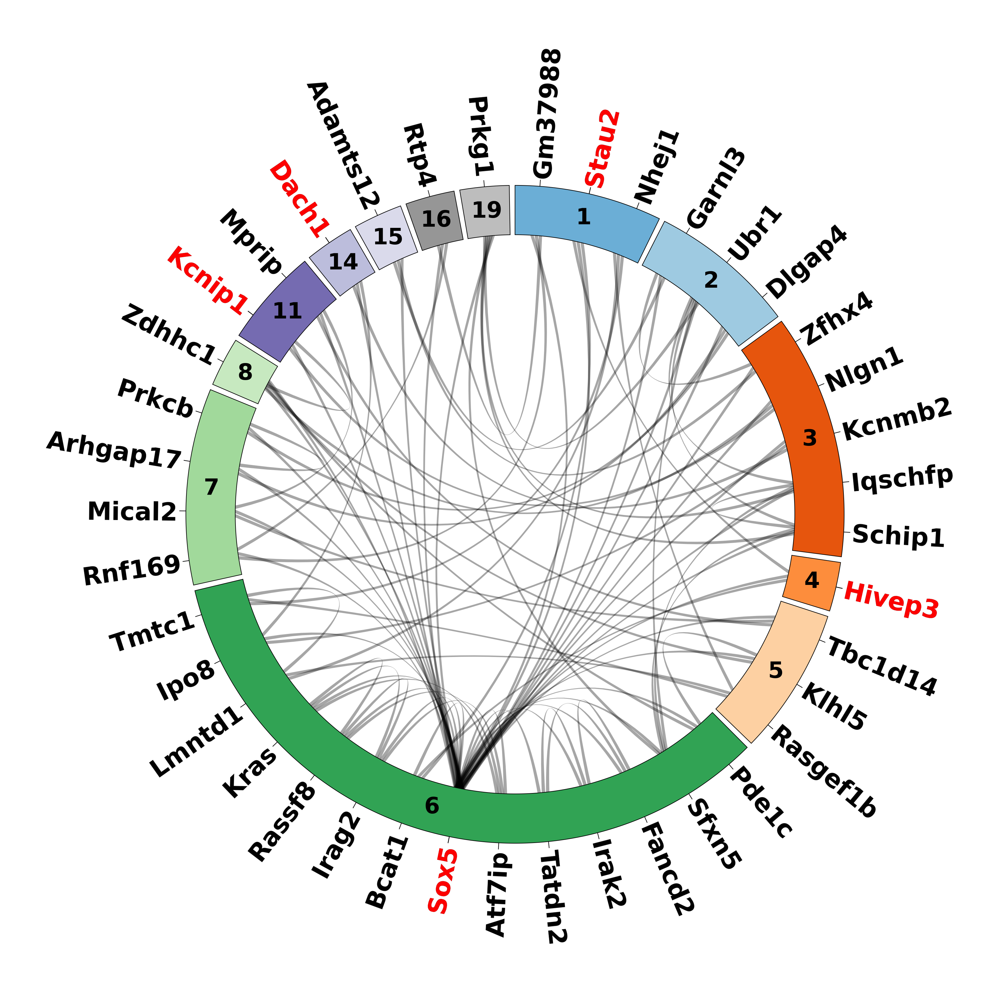

In [20]:
def get_pairs(query, normalize=True):
    # get the total number of gene pairs each gene is involved in
    H = pd.pivot_table(
        query, 
        index='read_name', 
        columns='gene_name',
        values='val',
        fill_value=0.0
    )
    A = (H.T @ H)
    np.fill_diagonal(A.to_numpy(), 0.0)
    if normalize:
        A = matrix.normalize_kr(A).todense()
    A = pd.DataFrame(A, index=H.columns, columns=H.columns)
    return A

def get_offset_coords(gene_dict, n_pairs, width=0.1):
    """A function to make offset coordinates.
    Width should be less than 0.5 (or the space between genes """
    offsets = {}

    for gene, meta in gene_dict.items():
        pos = meta['position']
        n_pairwise = n_pairs[gene]
        intervals = np.linspace(pos-width, pos+width, n_pairwise)
        offsets[gene] = {
            'index' : 0,
            'intervals' : intervals
        }
    return offsets


def flatten_pairs(pair_counts):
    # Get lower triangular indices
    rows, cols = np.nonzero(np.tril(pair_counts))
    
    # Extract values and create DataFrame
    pairs = pd.DataFrame({
        'i': pair_counts.index[rows],
        'j': pair_counts.columns[cols],
        'value': pair_counts.values[rows, cols]
    })

    pairs = pairs[pairs['i'] != pairs['j']]
    pairs = pairs.sort_values(by='value', ascending=False)

    return pairs

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 10, 10
fig = plt.figure()
ax = fig.add_subplot(111, polar=True)

pair_counts = get_pairs(query, normalize=False)
pair_magnitude = get_pairs(query, normalize=True)
flat_pairs = flatten_pairs(pair_magnitude)
flat_pairs['color'] = plt2.get_n_colors(len(flat_pairs), cmap_name='binary')
flat_pairs = flat_pairs.set_index(['i', 'j'])

n_pairs = pair_counts.sum().to_dict()

circos, gene_dict = plot_circos(
    ax, query,
    pad=0.25, 
    chrom_cmap='tab20c',
)
offsets = get_offset_coords(gene_dict, n_pairs)

pad = 0.04

for read_name, group in query.groupby('read_name'):
    node_list = group['gene_name'].values
    pairs = list(combinations(node_list, 2))

    for i, j in pairs:
        chrom_i = gene_dict[i]['chrom']
        chrom_j = gene_dict[j]['chrom']

        pos_i = offsets[i]['intervals'][offsets[i]['index']]
        pos_j = offsets[j]['intervals'][offsets[j]['index']]

        # increment 
        offsets[i]['index'] = offsets[i]['index'] + 1
        offsets[j]['index'] = offsets[j]['index'] + 1

        # # color
        # try:
        #     color = flat_pairs.loc[(i, j)]['color']
        # except:
        #     color =  flat_pairs.loc[(j, i)]['color']
        # # print()

        circos.link(
            (chrom_i, pos_i-pad, pos_i+pad), 
            (chrom_j, pos_j-pad, pos_j+pad), 
            color='k',
            lw=0.0, 
            height_ratio=0.15,
            alpha=0.35, 
            allow_twist=False,
        )
        
fig = circos.plotfig(
    ax=ax,
)

In [21]:
# plt.rcParams['figure.dpi'] = 300
# plt.rcParams['figure.figsize'] = 10, 10
# fig = plt.figure()
# ax = fig.add_subplot(111, polar=True)

# circos, gene_dict = plot_circos(ax, query, pad=0.25, chrom_cmap='tab20c')

# read_colors = plt2.get_n_colors(query['read_name'].nunique(), cmap_name='tab20b')
# read_colors = dict(zip(
#     query['read_name'].unique(),
#     read_colors,
# ))

# print(len(read_colors))

# for read_name, group in query.groupby('read_name'):
#     node_list = group['gene_name'].values
#     pairs = list(combinations(node_list, 2))

#     for i, j in pairs:
#         lw  = pair_counts.loc[i, j] * line_scale
#         circos.link(
#             (gene_dict[i]['chrom'], gene_dict[i]['position'], gene_dict[i]['position']), 
#             (gene_dict[j]['chrom'], gene_dict[j]['position'], gene_dict[j]['position']), 
#             color=read_colors[read_name],
#             lw=5, 
#             height_ratio=0.15,
#             alpha=0.5, 
#         )
        
# fig = circos.plotfig(
#     ax=ax,
# )

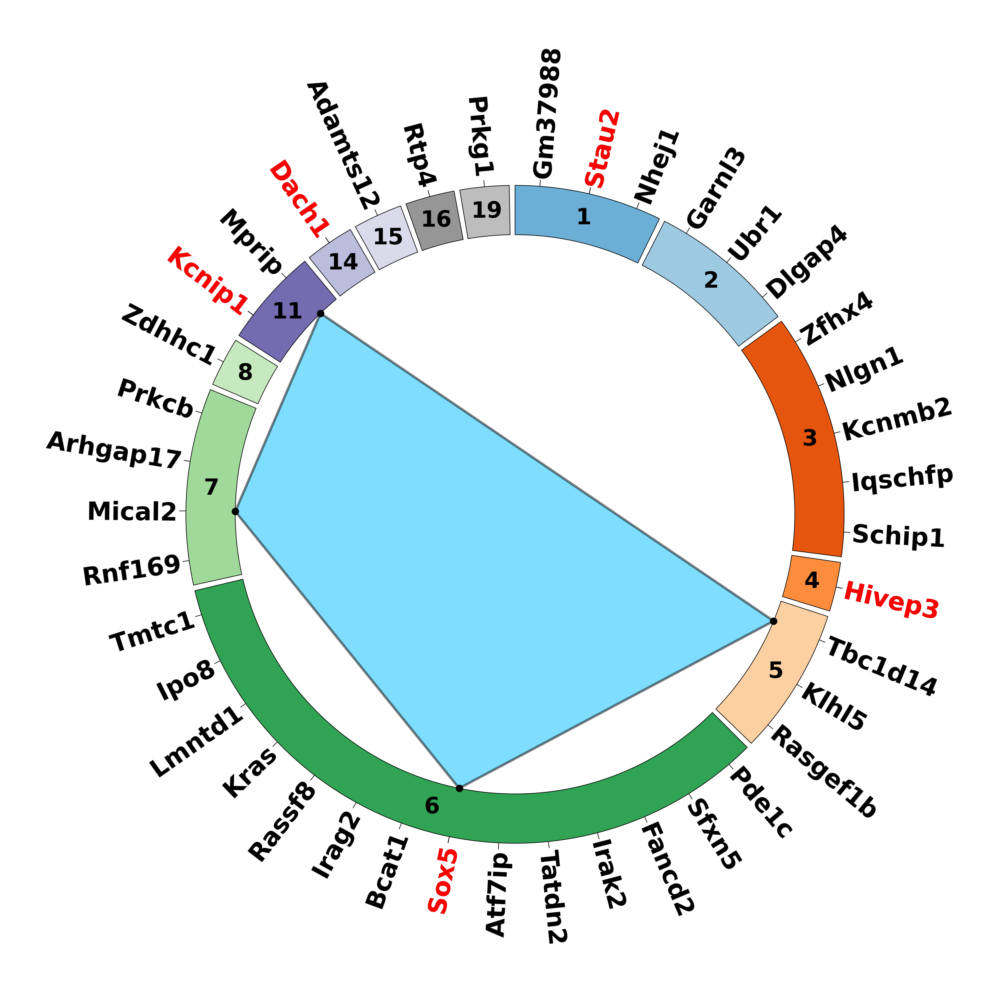

In [22]:
def node_to_coord(node, gene_dict=gene_dict, circos=circos):
    """Converts a gene name to its polar coordinates on a Circos plot.

    Args:
        node: Gene name.
        gene_dict: Dictionary mapping gene names to chromosome and position data.
        circos: Circos object.

    Returns:
        tuple: Polar coordinates (x, r) of the gene on the Circos plot.
    """
    d = gene_dict[node]
    chromosome = d['chrom']
    position = d['position']
    sector = circos.get_sector(chromosome)
    r = sector.get_lowest_r()
    x = sector.x_to_rad(position)
    return x, r


plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 10, 10
fig = plt.figure()
ax = fig.add_subplot(111, polar=True)

circos, gene_dict = plot_circos(ax, query, pad=0.25, chrom_cmap='tab20c')

for read_name, group in query.groupby('read_name'):
    color = 'deepskyblue'

    # get nodes
    node_list = group['gene_name'].values
    polygon_coords = np.asarray([node_to_coord(x) for x in node_list])

    poly = patches.Polygon(
        polygon_coords, 
        closed=True, 
        alpha=0.5, 
        facecolor=color,
        ec='k',
        linewidth=2,
        zorder=30,
    )  

    ax.add_patch(poly)

    ax.scatter(
        polygon_coords[:, 0],
        polygon_coords[:, 1],
        zorder=35,
        c='k',
        s=35,
        marker='o'
    )

    break
    

fig = circos.plotfig(
    ax=ax,
)

In [23]:
# plt.rcParams['figure.dpi'] = 300
# plt.rcParams['figure.figsize'] = 10, 10
# fig = plt.figure()
# ax = fig.add_subplot(111, polar=True)

# read_colors = plt2.get_n_colors(query['read_name'].nunique(), cmap_name='hsv')
# read_colors = dict(zip(
#     query['read_name'].unique(),
#     read_colors,
# ))

# print(len(read_colors))


# circos, gene_dict = plot_circos(ax, query, pad=0.25, chrom_cmap='tab20c')

# for read_name, group in query.groupby('read_name'):
#     order = len(group)
#     node_list = group['gene_name'].values
#     pairs = list(combinations(node_list, 2))

#     if order == 4 and np.random.random() > 0.75:
        
#         polygon_coords = np.asarray([node_to_coord(x) for x in node_list])
    
#         poly = patches.Polygon(
#             polygon_coords, 
#             closed=True, 
#             alpha=0.5, 
#             facecolor=read_colors[read_name],
#             ec='k',
#             linewidth=2,
#             zorder=30,
#         )  
    
#         ax.add_patch(poly)
    
#         ax.scatter(
#             polygon_coords[:, 0],
#             polygon_coords[:, 1],
#             zorder=0,
#             c='k',
#             s=35,
#             marker='o'
#         )

#     for i, j in pairs:
#         circos.link(
#             (gene_dict[i]['chrom'], gene_dict[i]['position'], gene_dict[i]['position']), 
#             (gene_dict[j]['chrom'], gene_dict[j]['position'], gene_dict[j]['position']), 
#             color='k',
#             lw=1.0, 
#             height_ratio=0.15, 
#         )
        
# fig = circos.plotfig(
#     ax=ax,
# )

# Map all of a given order

Found 10 reads of 4 for Sox5


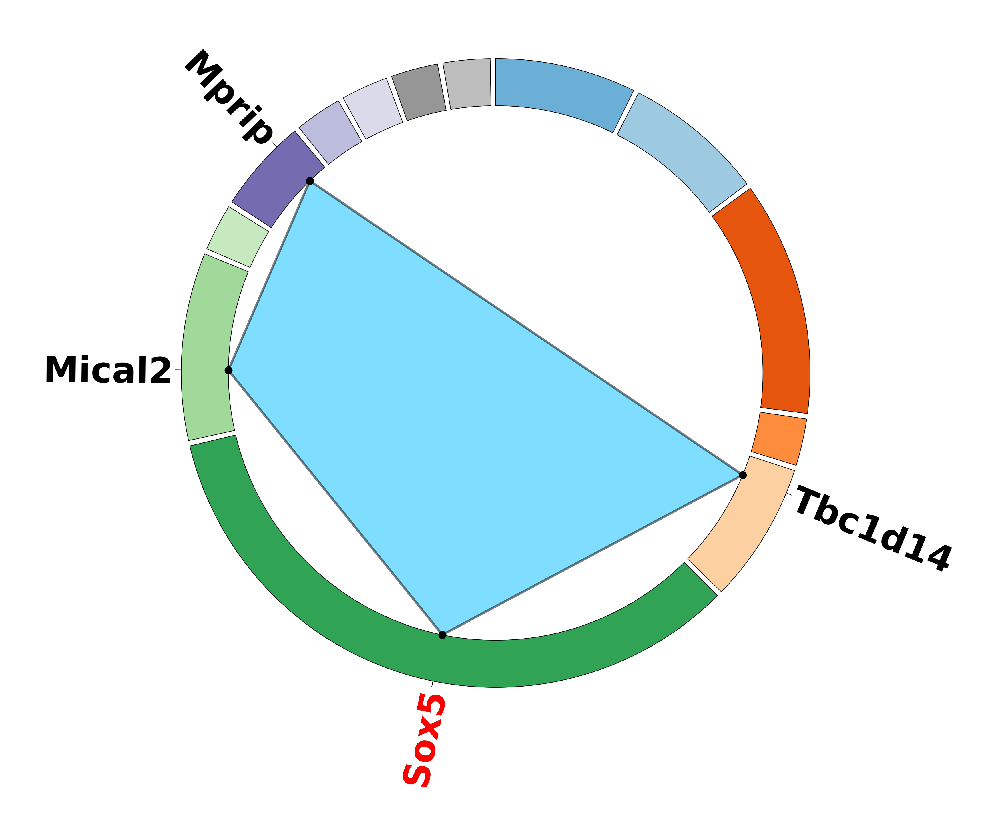

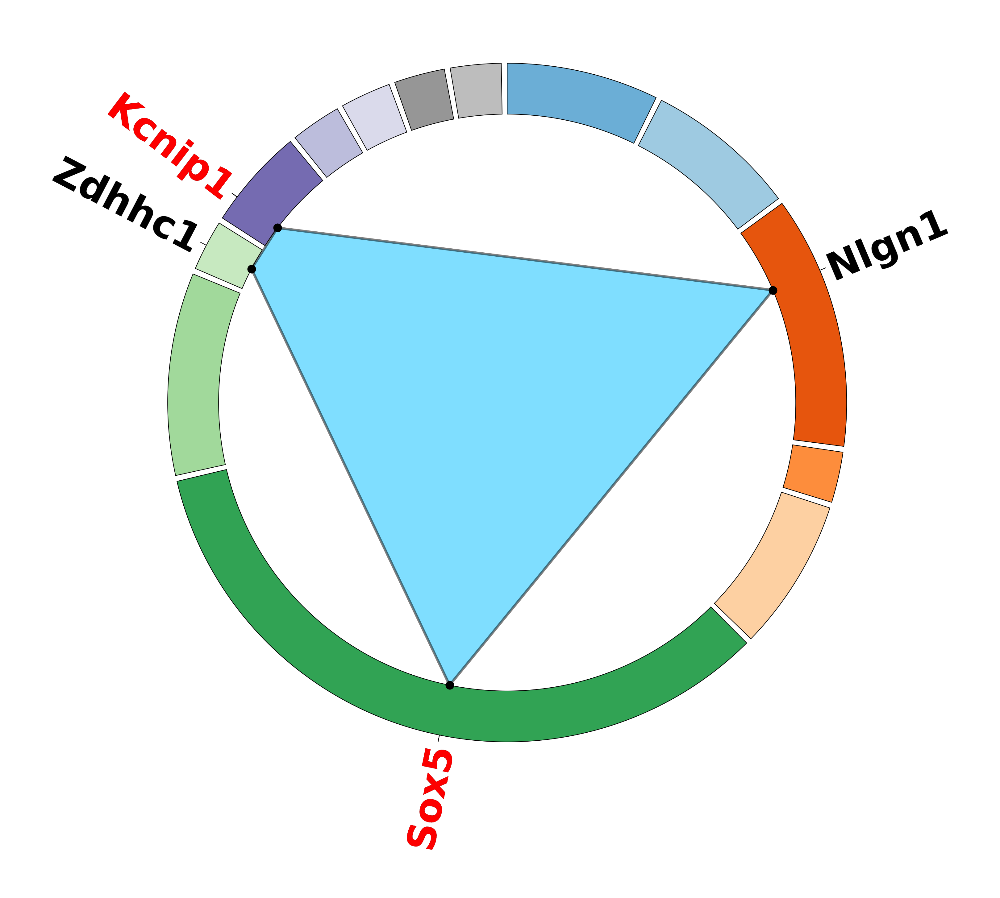

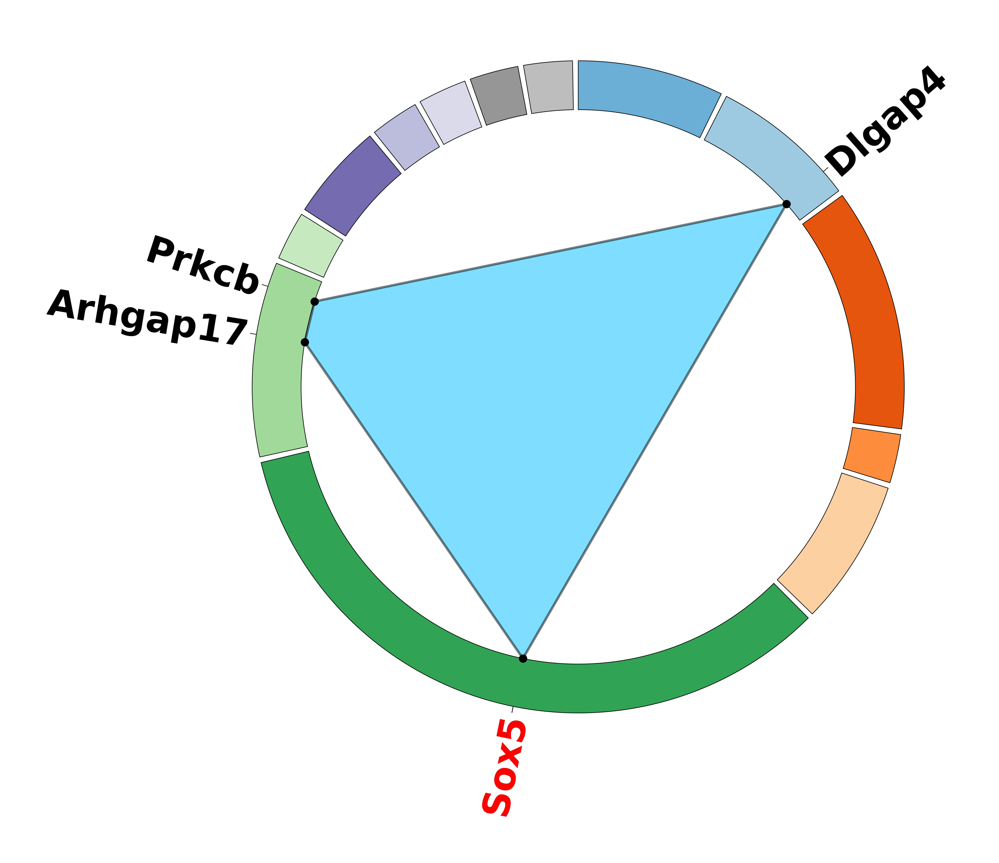

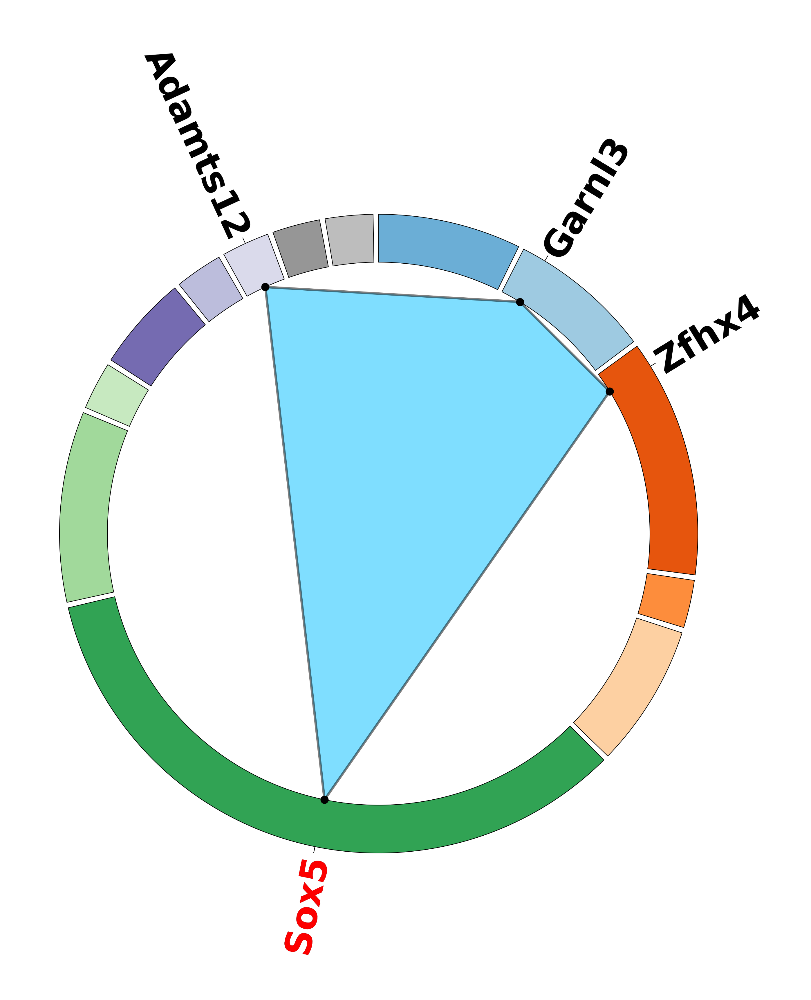

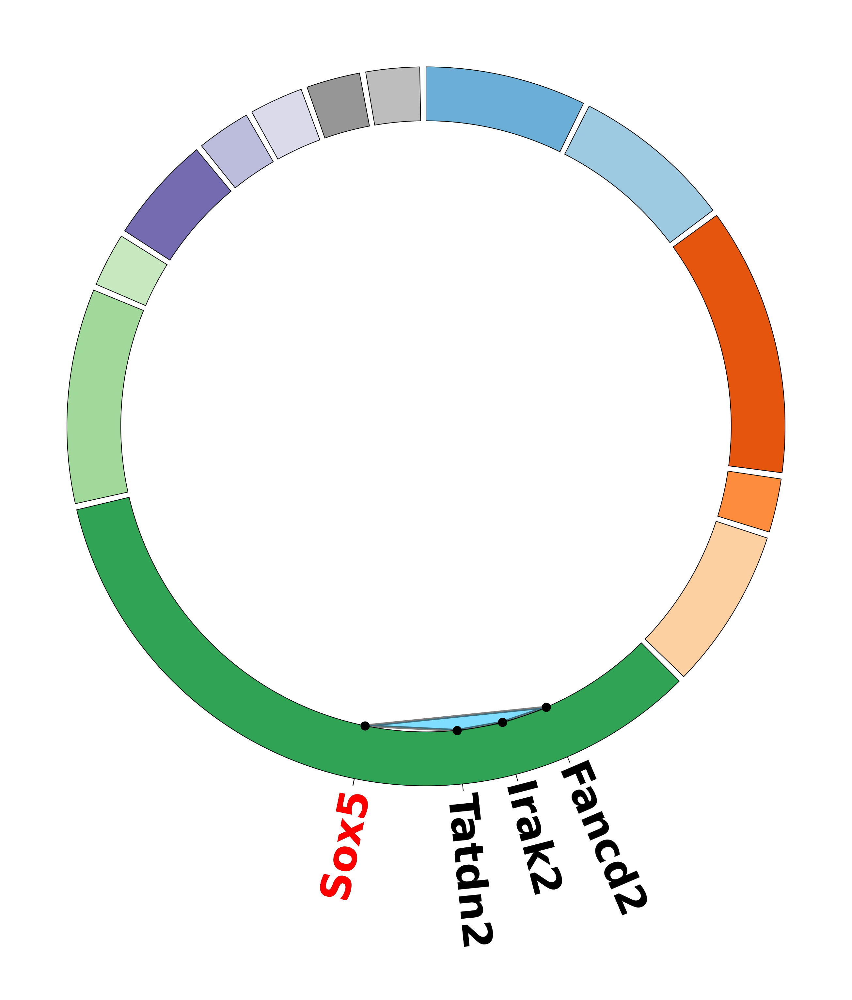

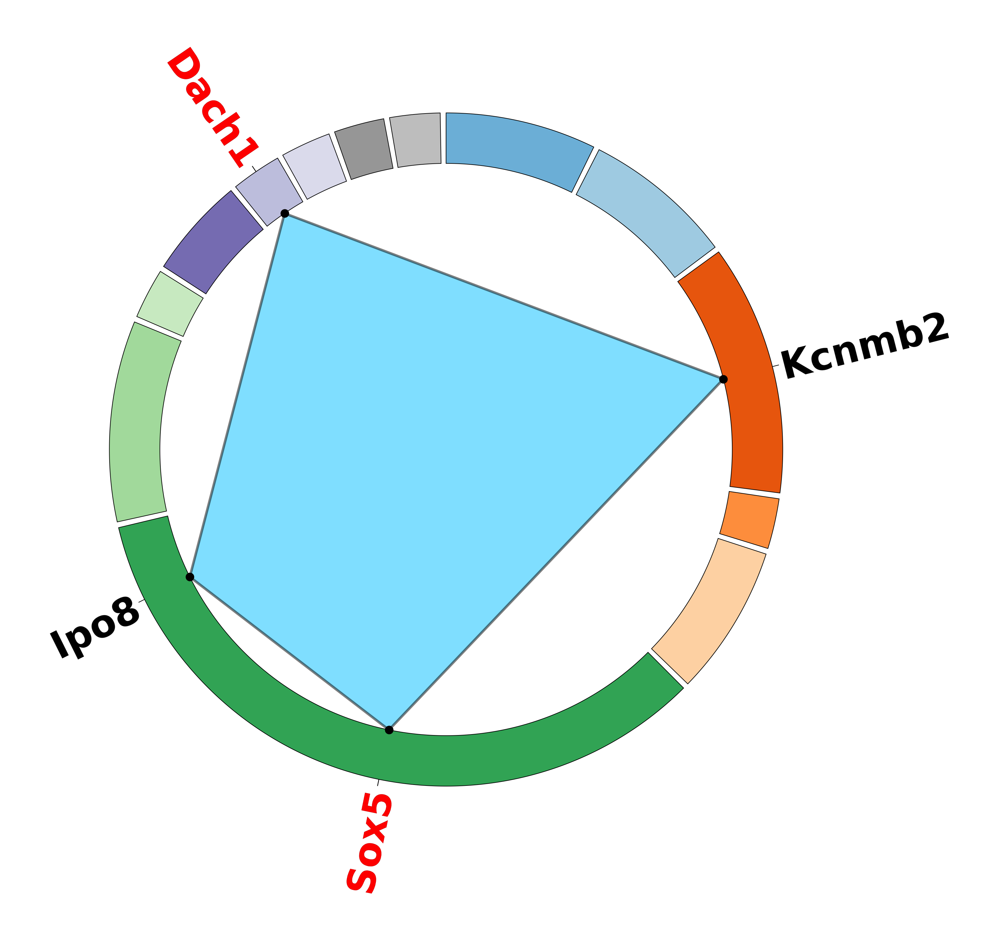

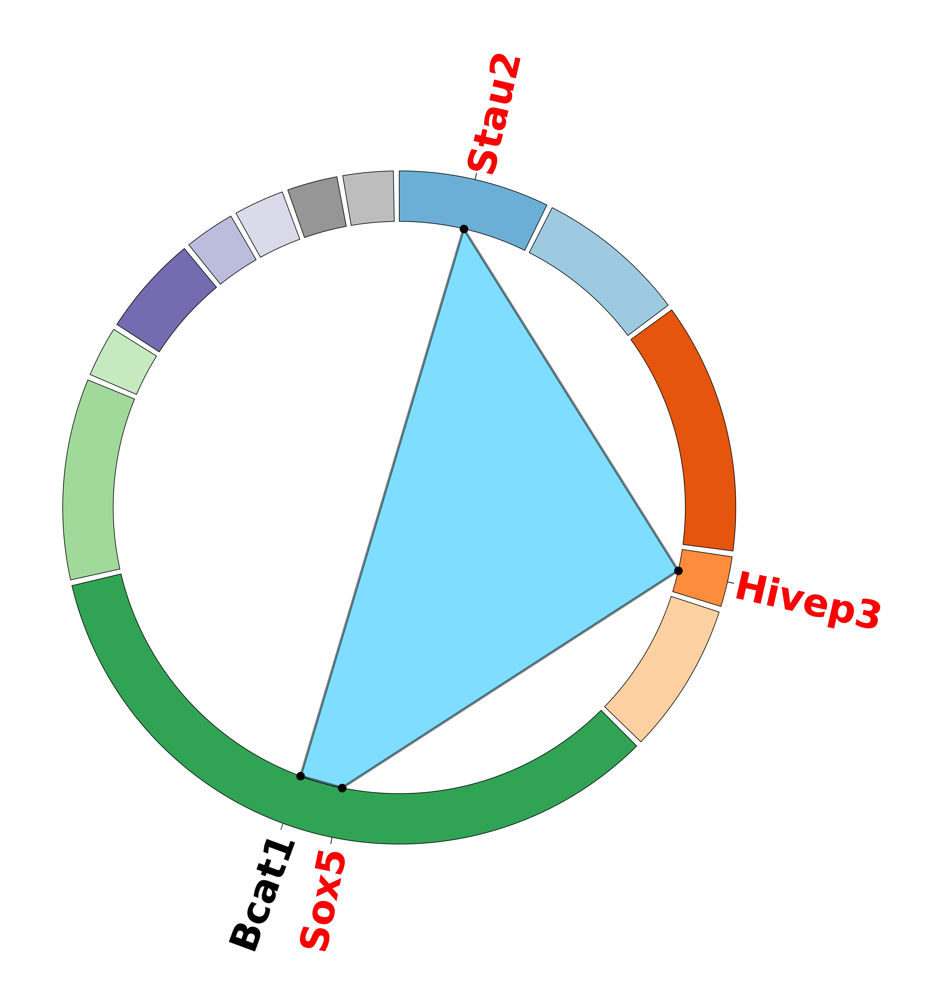

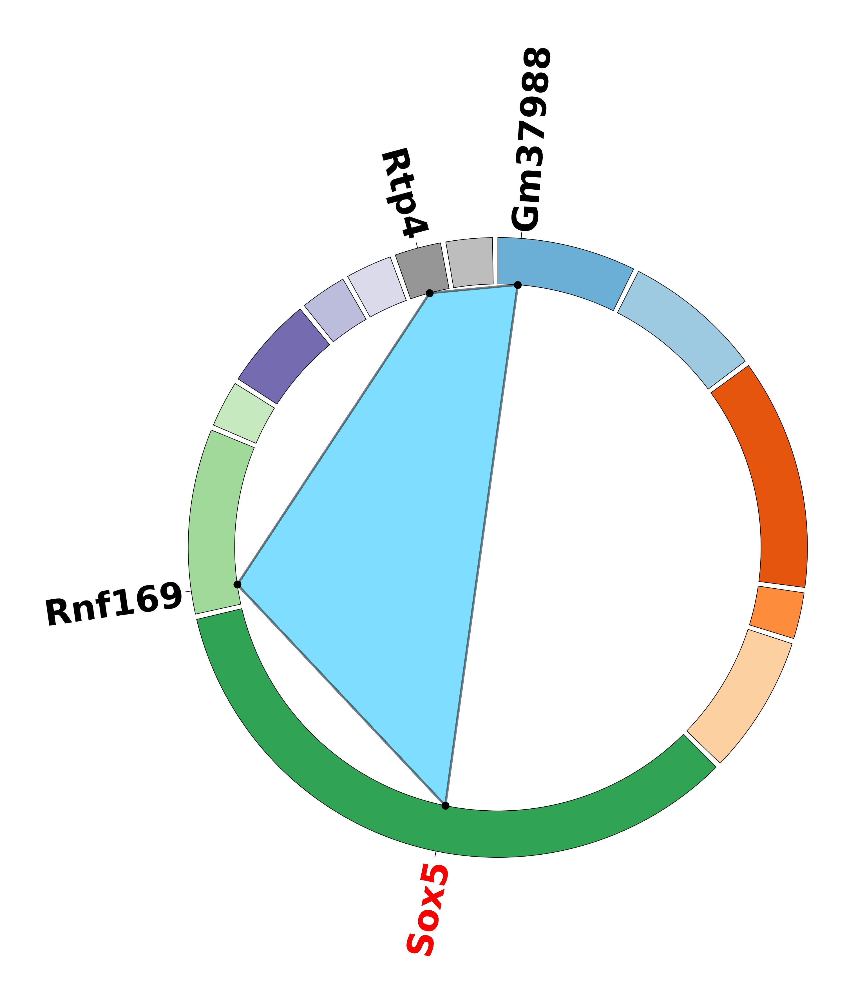

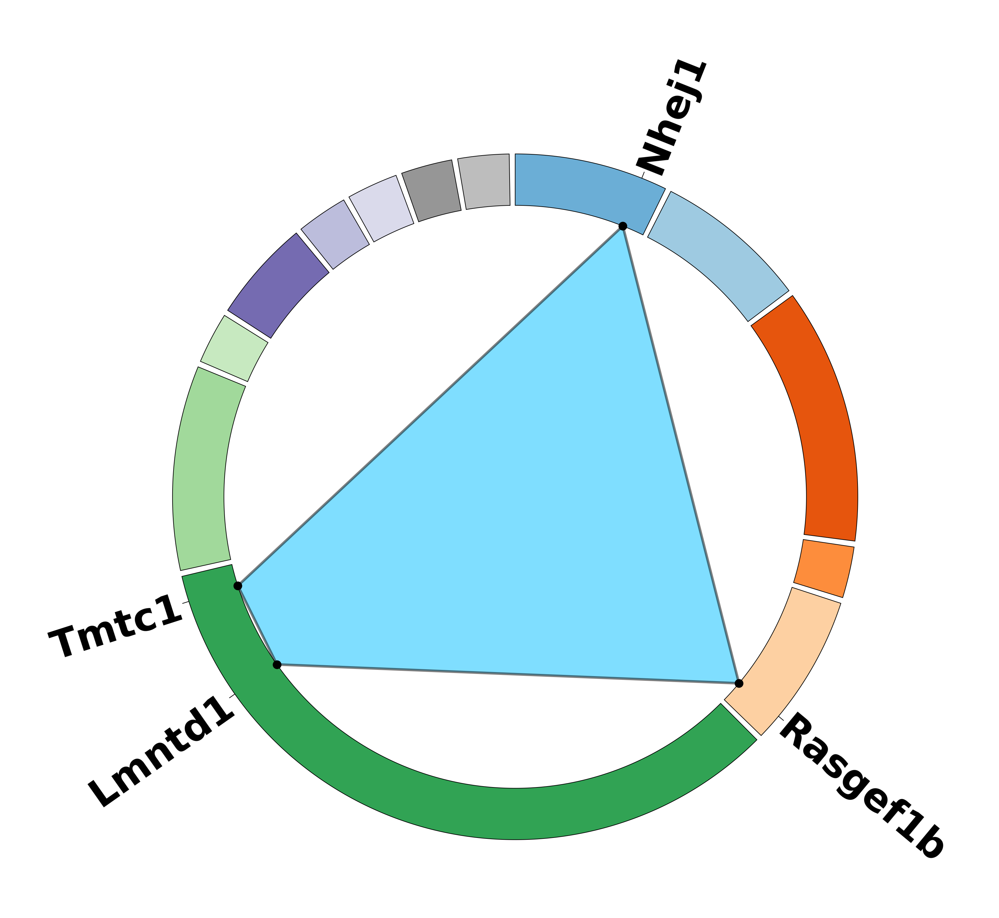

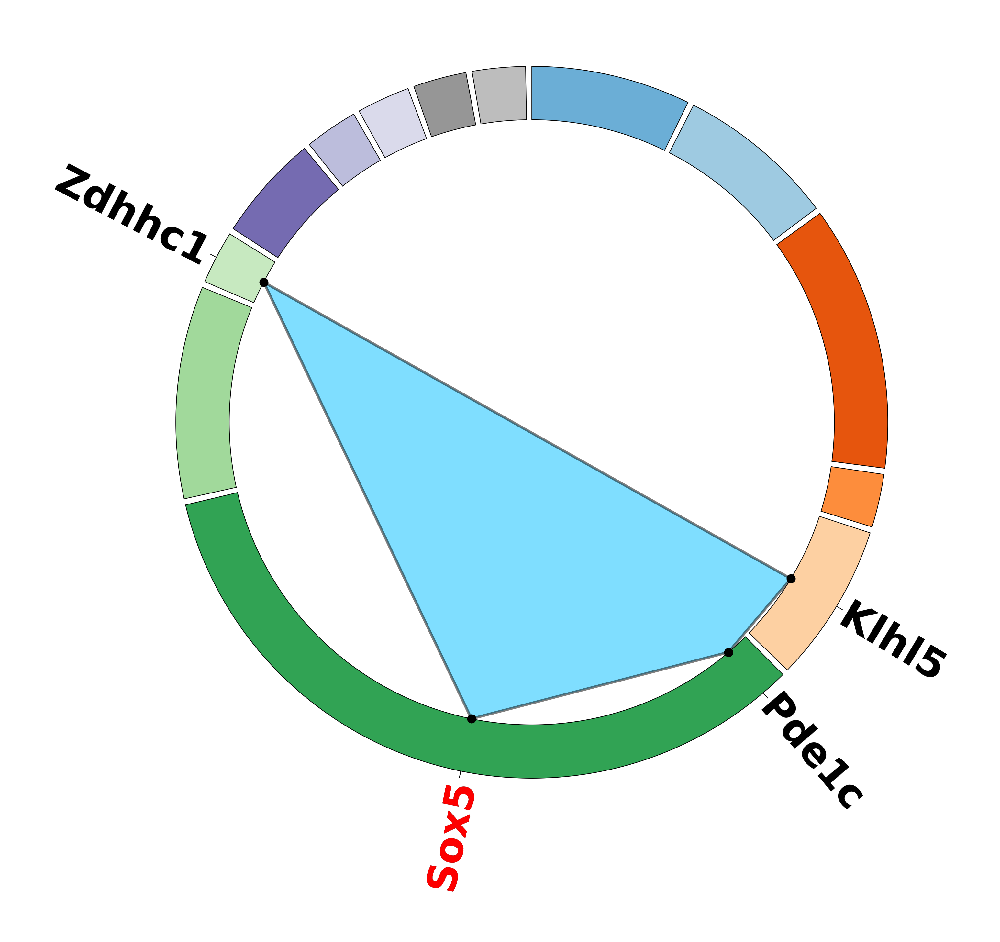

In [24]:
order = 4
color = 'deepskyblue'


filtered_query = query[query['query_order'] == order]
if not len(filtered_query) > 0:
    raise ValueError(f"No interactions of {order} for {tf}!")
else:
    n_plot = filtered_query['read_name'].nunique()
    print(f"Found {n_plot} reads of {order} for {tf}")


for read_name, group in filtered_query.groupby('read_name'):
    plt.rcParams['figure.dpi'] = 300
    plt.rcParams['figure.figsize'] = 10, 10
    fig = plt.figure(facecolor='none')
    ax = fig.add_subplot(111, polar=True)

    circos, gene_dict = plot_circos(
        ax, 
        query, 
        fontsize=30,
        label_chroms=False,
        label_genes=False,
        pad=0.25,
        chrom_cmap='tab20c',
    )

    node_list = group['gene_name'].values

    """ RESET axis ticks """

    for chrom, chrom_group in group.groupby('chrom'):
        chrom_group = chrom_group.reset_index()
        sector = circos.get_sector(chrom)
        track = sector.get_track('chrom_block')

        labels = chrom_group['gene_name'].values
        xticks = np.asarray([gene_dict[x]['position'] for x in labels])
     
        track.xticks(
            x = xticks,
            labels = labels,
            label_orientation='vertical',
            label_size=30,
            text_kws={'color' : 'k', 'fontweight' : 'bold'},
        )

        # any TFs?
        tfs = chrom_group[chrom_group['is_tf']]
        if not tfs.empty:
            tf_indices = np.asarray(tfs.index)
            tf_labels = tfs['gene_name'].values
            tf_ticks = xticks[tf_indices]
            
            track.xticks(
                x = tf_ticks,
                labels = tf_labels,
                label_orientation='vertical',
                label_size=30,
                text_kws={'color' : 'r', 'fontweight' : 'bold'},
            )

    """ PLOT the polygons """
    polygon_coords = np.asarray([node_to_coord(x) for x in node_list])
    
    poly = patches.Polygon(
        polygon_coords, 
        closed=True, 
        alpha=0.5, 
        facecolor=color,
        ec='k',
        linewidth=2,
        zorder=30,
    )  
    
    ax.add_patch(poly)

    ax.scatter(
        polygon_coords[:, 0],
        polygon_coords[:, 1],
        zorder=55,
        c='k',
        s=45,
        marker='o'
    )
    
    fig = circos.plotfig(
        ax=ax,
    )

    plt.show()

# A new query

In [25]:
tf = "Msi2"
order_threshold = 3
read_threshold = 2
pt_only = True
core_only = True

""" EXTRACT reads containing the gene of interest """
query_reads = df[df['gene_name'] == tf]['read_name'].unique()
print(f"detected {len(query_reads)} reds with {tf}")
query = df[df['read_name'].isin(query_reads)].copy()

""" FILTER reads and genes """
if pt_only:
    query = query[query['gene_biotype'] == 'protein_coding']

if core_only:
    query = query[query['is_core']]

query['reads_per_gene'] = query.groupby('gene_name')['read_name'].transform('nunique')
query = query[query['reads_per_gene'] >= read_threshold]

query['query_order'] = query.groupby('read_name')['gene_name'].transform('nunique')
query = query[query['query_order'] > order_threshold]
print(f"{query.shape[0]} pass filters ({query['gene_name'].nunique()} genes)")

""" SORT genes and chroms byu genomic position """
bin_map = dict(zip(adata.obs.index, adata.obs['bin']))
query['bin'] = query['bin_name'].map(bin_map)
query = query.sort_values(by='bin')

""" ADD metdata for the plot """
query['chrom'] = query['bin_name'].str.split(":").str[0]

print(f"{query.shape=}")

query.head()

detected 1405 reds with Msi2
48 pass filters (27 genes)
query.shape=(48, 13)


,gene_name,gene_biotype,read_name,bin_name,is_tf,is_core,read_index,gene_index,val,reads_per_gene,query_order,bin,chrom
3316854,Dnm3,protein_coding,1b6112b0-eaf6-4202-bab1-45d24e23383d,chr1:162,False,True,1681647,3975,1,2,4,162,chr1
2003693,Babam2,protein_coding,6697bffc-606e-4570-8e8c-62492b9d2b41,chr5:32,False,True,384481,3401,1,4,4,727,chr5
2003450,Babam2,protein_coding,aca39293-21a8-4d5f-b6cf-fbae044ec176,chr5:32,False,True,80531,3401,1,4,4,727,chr5
1287309,Zan,protein_coding,97b0a47f-ea5f-4a61-b728-c78caa0e8de8,chr5:137,False,True,599574,1567,1,2,4,832,chr5
708455,Irak2,protein_coding,0575a0e3-e7f9-495e-8c44-47660a64920d,chr6:113,False,True,54779,12354,1,4,4,960,chr6


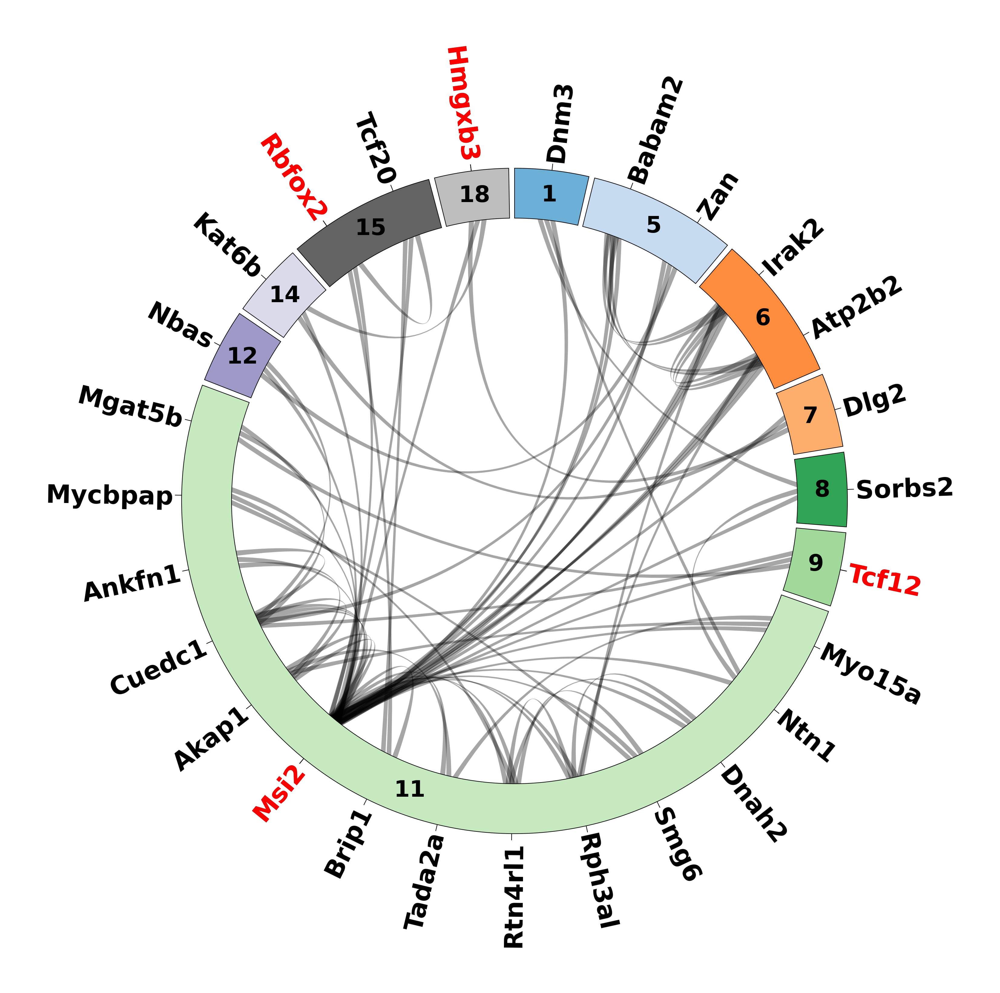

In [26]:
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 10, 10
fig = plt.figure()
ax = fig.add_subplot(111, polar=True)

pair_counts = get_pairs(query, normalize=False)
pair_magnitude = get_pairs(query, normalize=True)
flat_pairs = flatten_pairs(pair_magnitude)
flat_pairs['color'] = plt2.get_n_colors(len(flat_pairs), cmap_name='binary')
flat_pairs = flat_pairs.set_index(['i', 'j'])

n_pairs = pair_counts.sum().to_dict()

circos, gene_dict = plot_circos(
    ax, query,
    pad=0.25, 
    chrom_cmap='tab20c',
)
offsets = get_offset_coords(gene_dict, n_pairs)

pad = 0.04

for read_name, group in query.groupby('read_name'):
    node_list = group['gene_name'].values
    pairs = list(combinations(node_list, 2))

    for i, j in pairs:
        chrom_i = gene_dict[i]['chrom']
        chrom_j = gene_dict[j]['chrom']

        pos_i = offsets[i]['intervals'][offsets[i]['index']]
        pos_j = offsets[j]['intervals'][offsets[j]['index']]

        # increment 
        offsets[i]['index'] = offsets[i]['index'] + 1
        offsets[j]['index'] = offsets[j]['index'] + 1

        # # color
        # try:
        #     color = flat_pairs.loc[(i, j)]['color']
        # except:
        #     color =  flat_pairs.loc[(j, i)]['color']
        # # print()

        circos.link(
            (chrom_i, pos_i-pad, pos_i+pad), 
            (chrom_j, pos_j-pad, pos_j+pad), 
            color='k',
            lw=0.0, 
            height_ratio=0.15,
            alpha=0.35, 
            allow_twist=False,
        )
        
fig = circos.plotfig(
    ax=ax,
)

Found 12 reads of 4 for Msi2


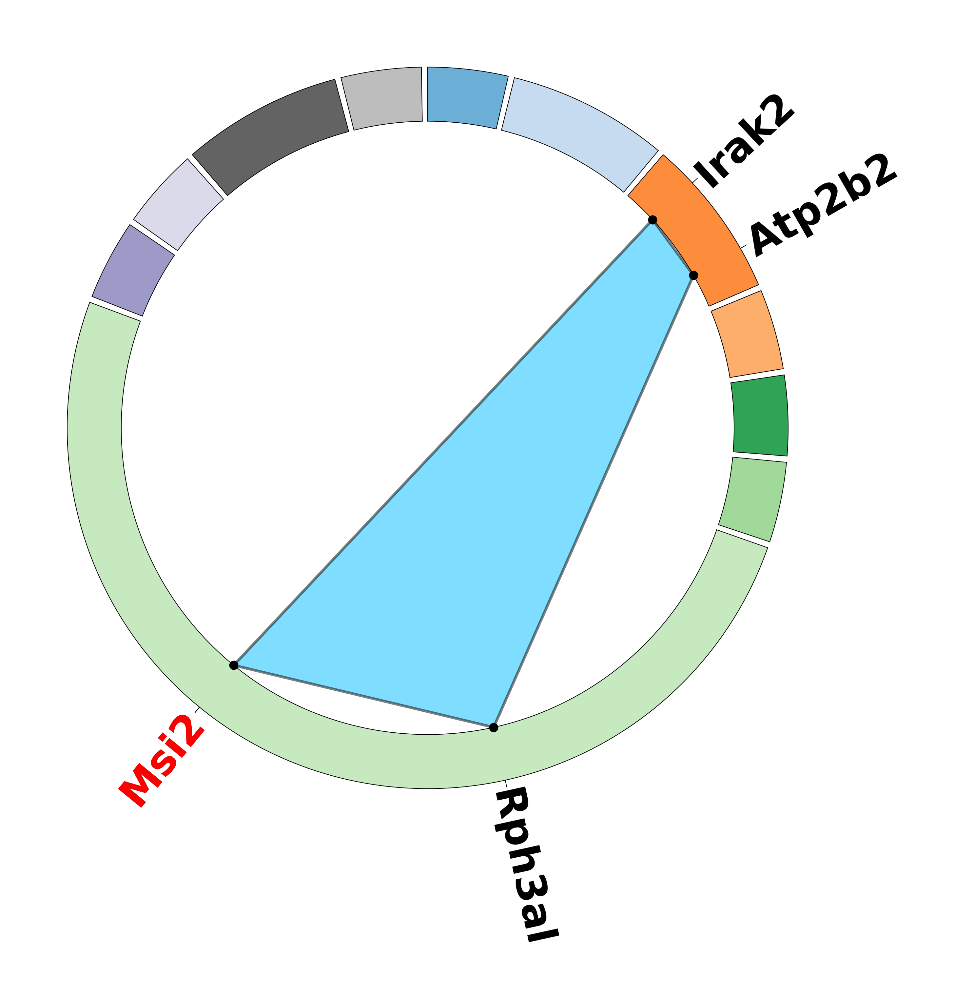

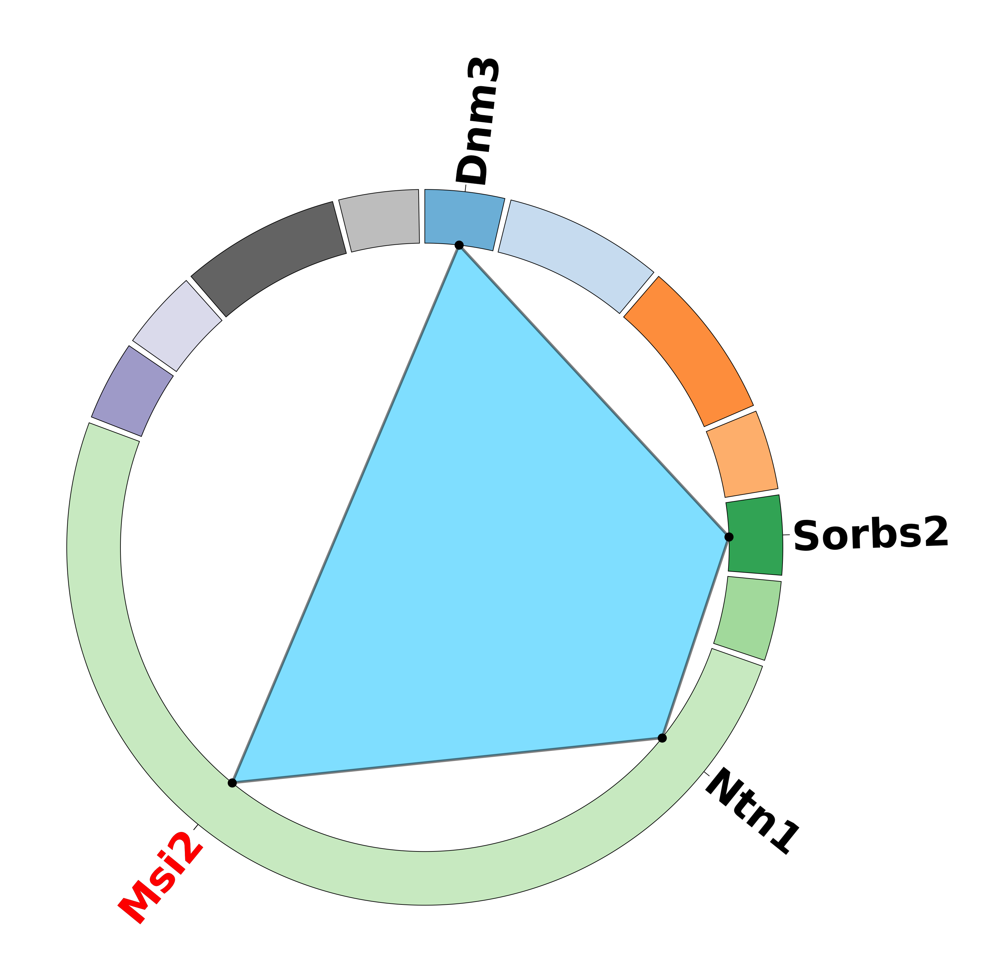

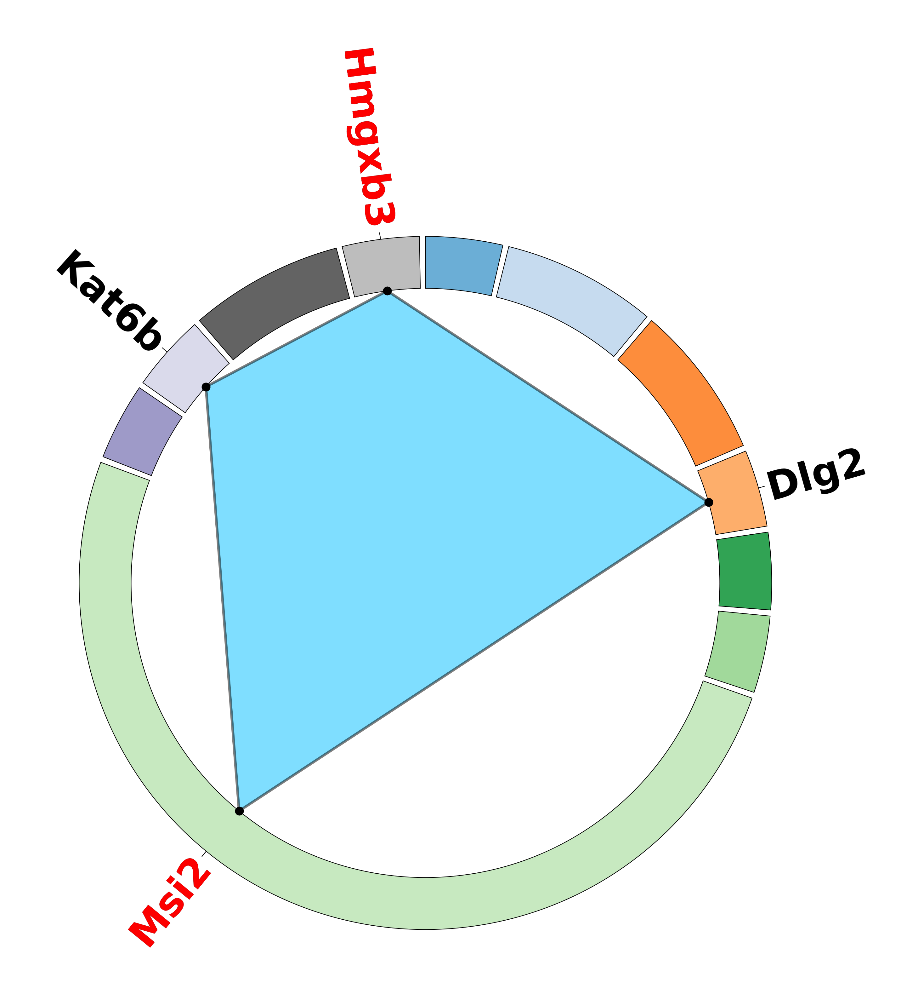

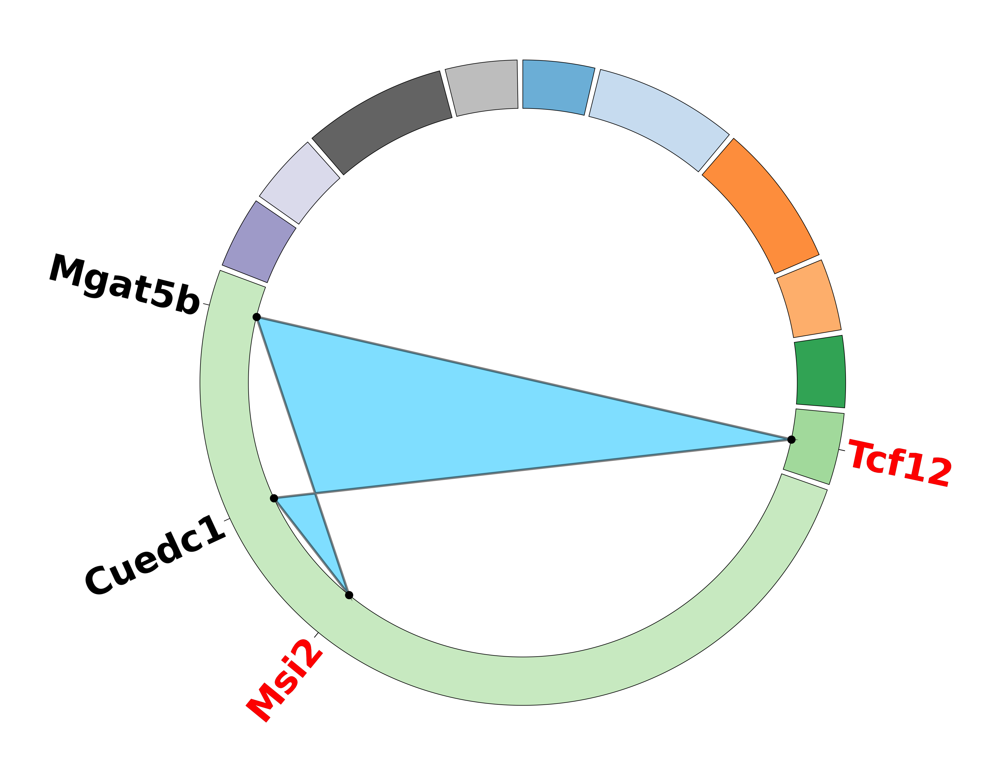

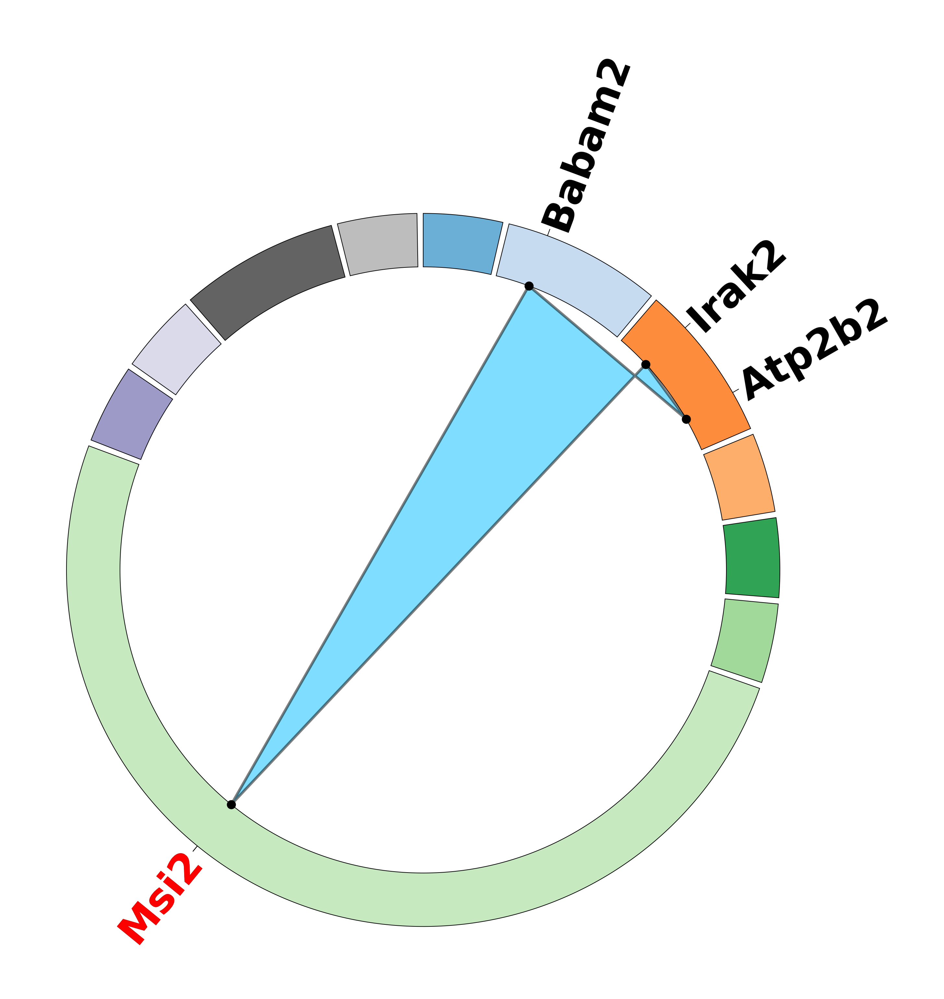

...

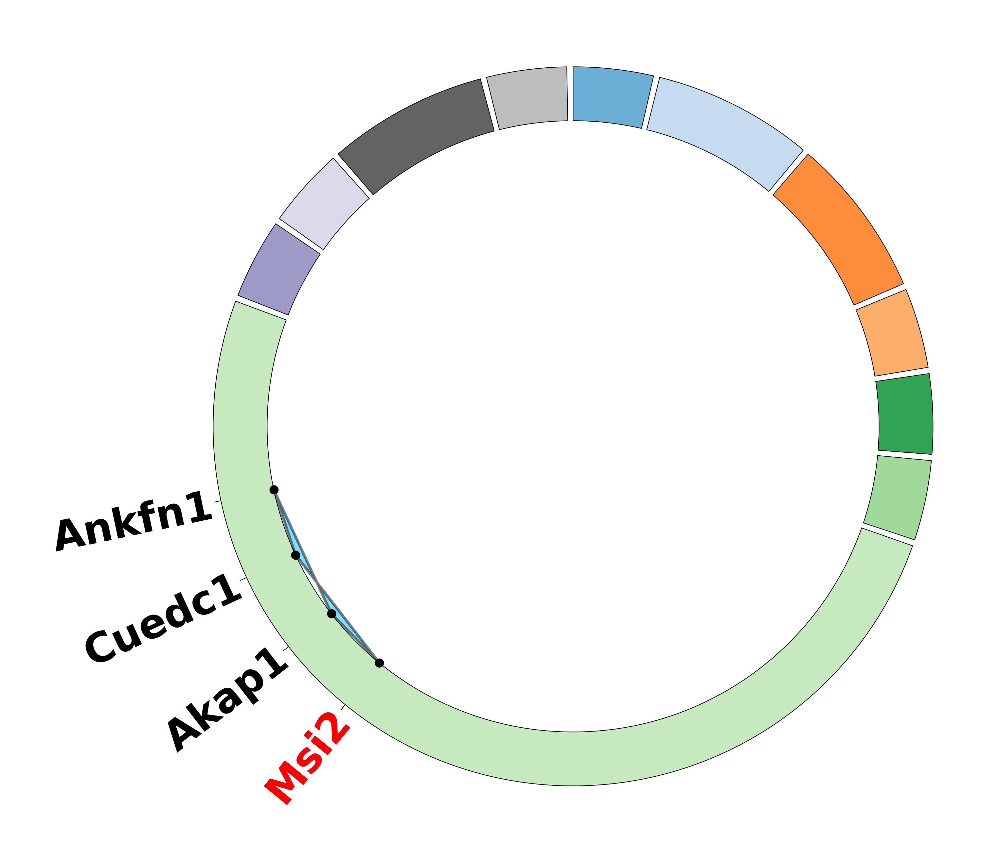

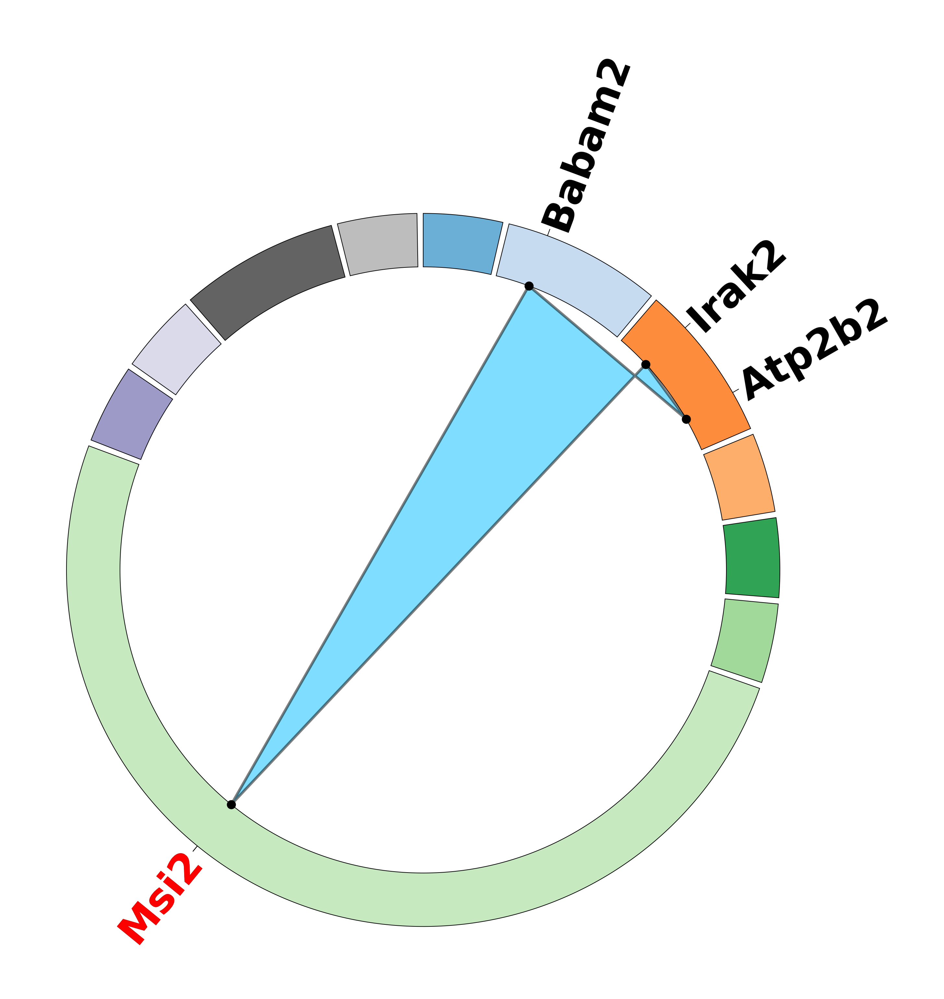

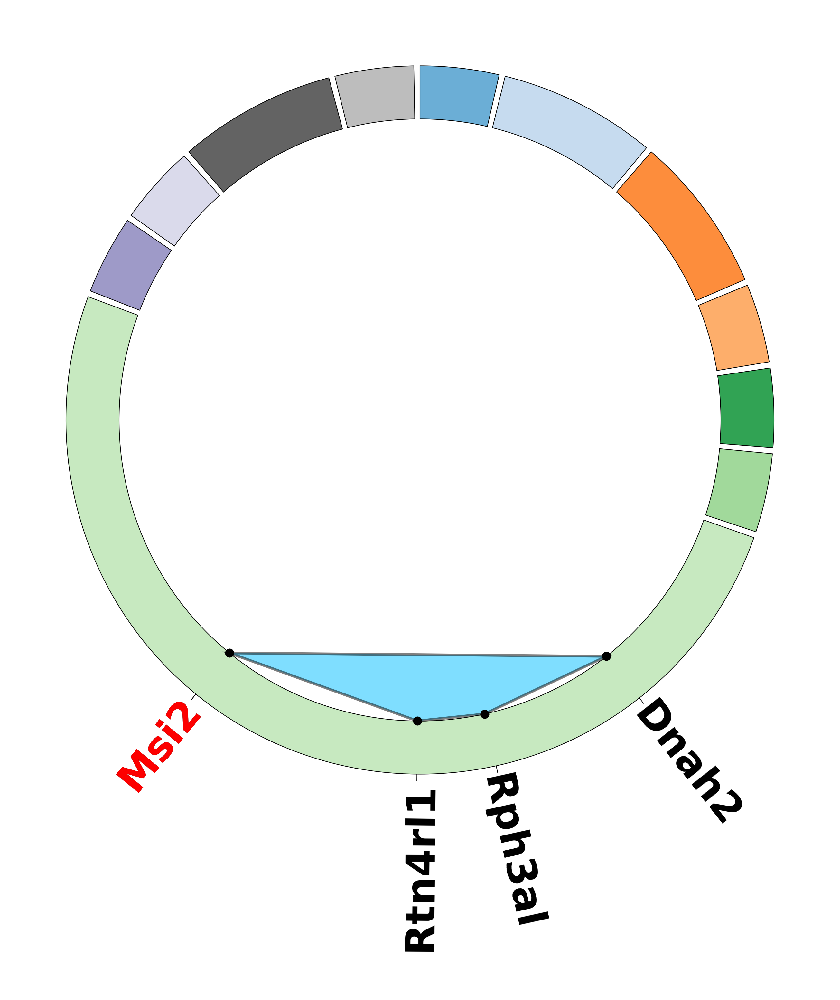

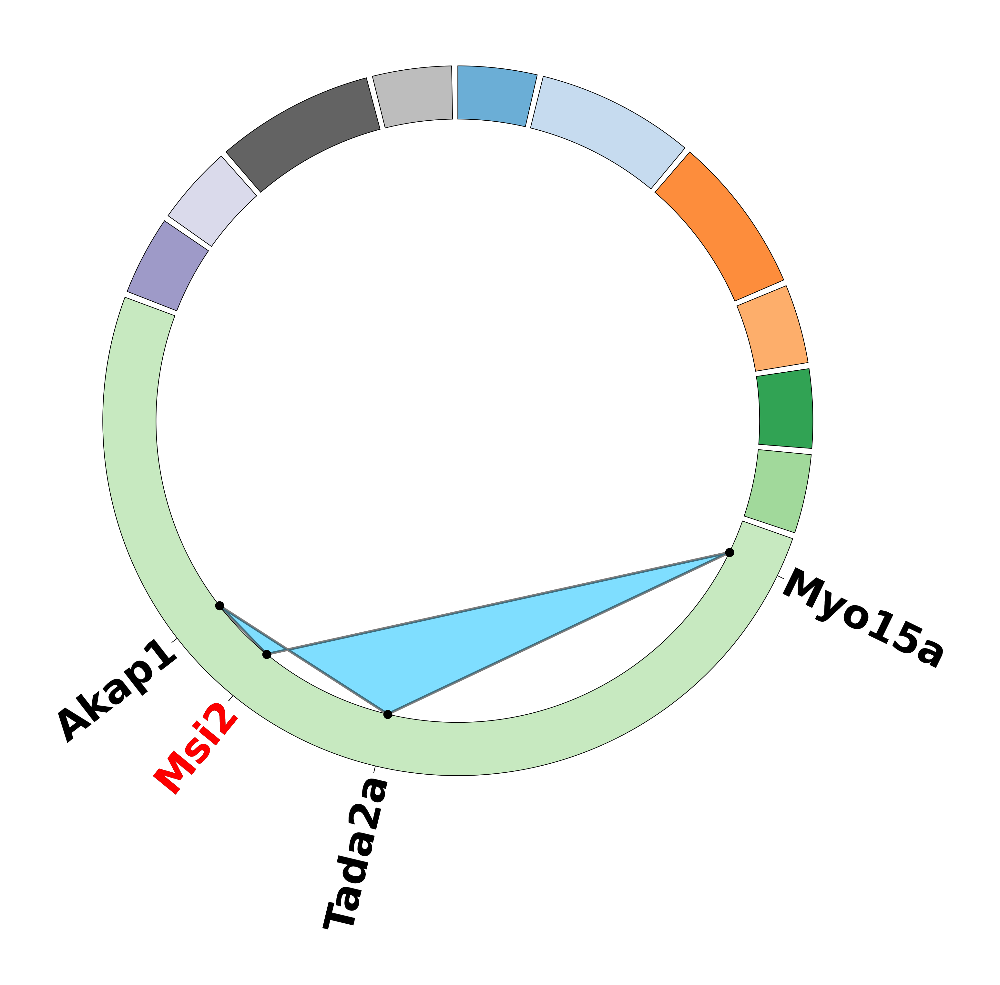

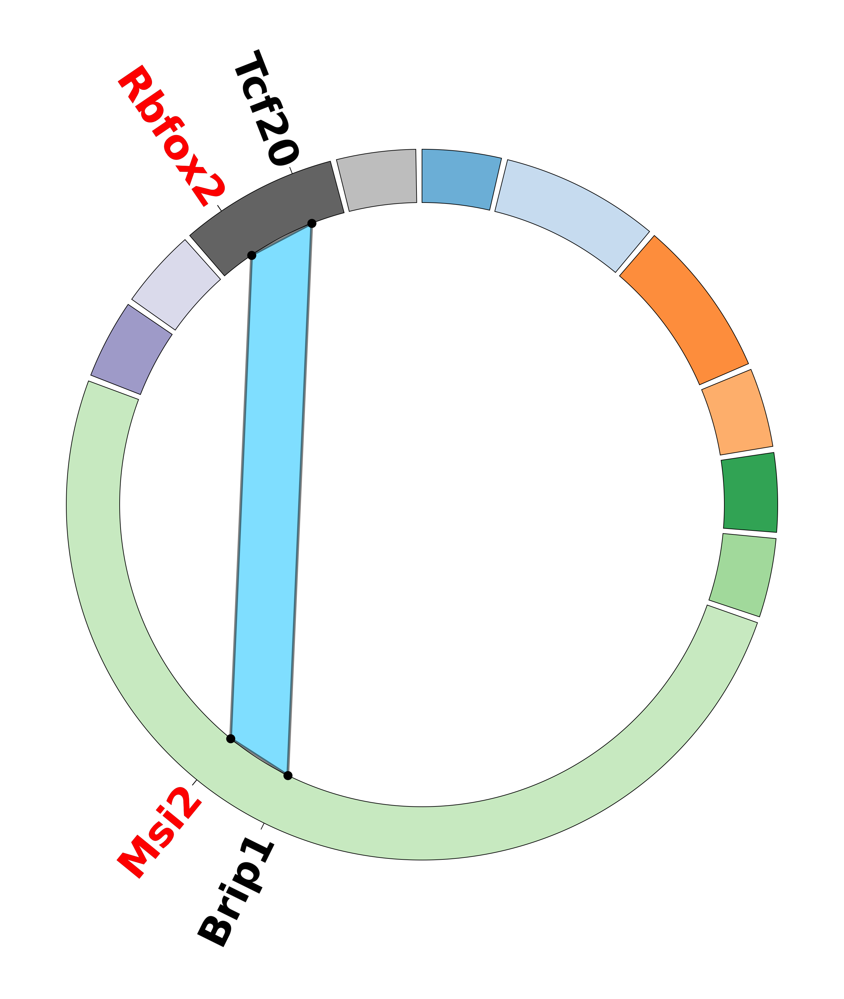

In [28]:
order = 4
color = 'deepskyblue'


filtered_query = query[query['query_order'] == order]
if not len(filtered_query) > 0:
    raise ValueError(f"No interactions of {order} for {tf}!")
else:
    n_plot = filtered_query['read_name'].nunique()
    print(f"Found {n_plot} reads of {order} for {tf}")


for read_name, group in filtered_query.groupby('read_name'):
    plt.rcParams['figure.dpi'] = 300
    plt.rcParams['figure.figsize'] = 10, 10
    fig = plt.figure(facecolor='none')
    ax = fig.add_subplot(111, polar=True)

    circos, gene_dict = plot_circos(
        ax, 
        query, 
        fontsize=30,
        label_chroms=False,
        label_genes=False,
        pad=0.25,
        chrom_cmap='tab20c',
    )

    node_list = group['gene_name'].values

    """ RESET axis ticks """

    for chrom, chrom_group in group.groupby('chrom'):
        chrom_group = chrom_group.reset_index()
        sector = circos.get_sector(chrom)
        track = sector.get_track('chrom_block')

        labels = chrom_group['gene_name'].values
        xticks = np.asarray([gene_dict[x]['position'] for x in labels])
     
        track.xticks(
            x = xticks,
            labels = labels,
            label_orientation='vertical',
            label_size=30,
            text_kws={'color' : 'k', 'fontweight' : 'bold'},
        )

        # any TFs?
        tfs = chrom_group[chrom_group['is_tf']]
        if not tfs.empty:
            tf_indices = np.asarray(tfs.index)
            tf_labels = tfs['gene_name'].values
            tf_ticks = xticks[tf_indices]
            
            track.xticks(
                x = tf_ticks,
                labels = tf_labels,
                label_orientation='vertical',
                label_size=30,
                text_kws={'color' : 'r', 'fontweight' : 'bold'},
            )

    """ PLOT the polygons """
    polygon_coords = np.asarray([node_to_coord(x, gene_dict=gene_dict, circos=circos) for x in node_list])
    
    poly = patches.Polygon(
        polygon_coords, 
        closed=True, 
        alpha=0.5, 
        facecolor=color,
        ec='k',
        linewidth=2,
        zorder=30,
    )  
    
    ax.add_patch(poly)

    ax.scatter(
        polygon_coords[:, 0],
        polygon_coords[:, 1],
        zorder=55,
        c='k',
        s=45,
        marker='o'
    )
    
    fig = circos.plotfig(
        ax=ax,
    )

    plt.show()

# Plot perfect polygons

In [36]:
pdf[pdf['is_tf'] & pdf['is_core'] & pdf['is_marker']]

,gene_name,gene_biotype,chrom,is_tf,is_core,is_pt,read_name,is_marker
9668,Gli2,protein_coding,chr1,True,True,True,928,True
40573,Rbfox2,protein_coding,chr15,True,True,True,919,True
8440,Esrrb,protein_coding,chr12,True,True,True,560,True
33975,Lef1,protein_coding,chr3,True,True,True,397,True
44186,Tead4,protein_coding,chr6,True,True,True,360,True
42846,Smad1,protein_coding,chr8,True,True,True,279,True
43564,Stat3,protein_coding,chr11,True,True,True,263,True
42853,Smad9,protein_coding,chr3,True,True,True,191,True
6641,Ctnnb1,protein_coding,chr9,True,True,True,121,True
45325,Trim28,protein_coding,chr7,True,True,True,114,True


In [175]:
tf = "Lef1"
order_threshold = 2
read_threshold = 1
pt_only = True
core_only = True

""" EXTRACT reads containing the gene of interest """
query_reads = df[df['gene_name'] == tf]['read_name'].unique()
print(f"detected {len(query_reads)} reds with {tf}")
query = df[df['read_name'].isin(query_reads)].copy()

""" FILTER reads and genes """
if pt_only:
    query = query[query['gene_biotype'] == 'protein_coding']

if core_only:
    query = query[query['is_core']]

query['reads_per_gene'] = query.groupby('gene_name')['read_name'].transform('nunique')
query = query[query['reads_per_gene'] >= read_threshold]

query['query_order'] = query.groupby('read_name')['gene_name'].transform('nunique')
query = query[query['query_order'] > order_threshold]
print(f"{query.shape[0]} pass filters ({query['gene_name'].nunique()} genes)")

""" SORT genes and chroms byu genomic position """
bin_map = dict(zip(adata.obs.index, adata.obs['bin']))
query['bin'] = query['bin_name'].map(bin_map)
query = query.sort_values(by='bin')

""" ADD metdata for the plot """
query['chrom'] = query['bin_name'].str.split(":").str[0]

print(f"{query.shape=}")

query.head()

detected 461 reds with Lef1
144 pass filters (101 genes)
query.shape=(144, 13)


,gene_name,gene_biotype,read_name,bin_name,is_tf,is_core,read_index,gene_index,val,reads_per_gene,query_order,bin,chrom
2049006,Mob4,protein_coding,9bbfcc0a-3bd0-4c4a-9600-704a6562c03c,chr1:55,False,True,1044014,12648,1,2,3,55,chr1
2083909,Mob4,protein_coding,f276ef07-2cfe-4c2f-aadc-c4824c9f44b4,chr1:55,False,True,1032914,12648,1,2,3,55,chr1
3366879,Desi2,protein_coding,c10a8a08-a9d6-4d9e-aa37-3bc4f9b512cb,chr1:178,False,True,830246,3776,1,1,3,178,chr1
102604,Adamtsl2,protein_coding,8dfa9938-72f7-456f-8bbf-5e43dab44217,chr2:26,False,True,99722,3056,1,1,6,222,chr2
3179939,Adamts13,protein_coding,8dfa9938-72f7-456f-8bbf-5e43dab44217,chr2:26,False,True,99722,5685,1,1,6,222,chr2


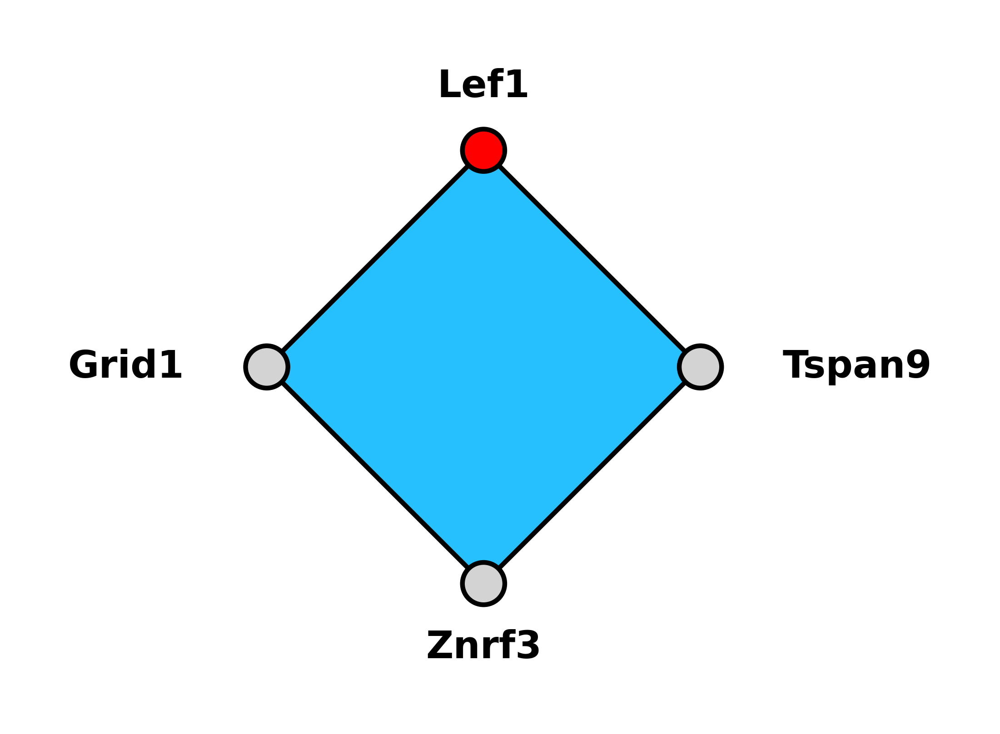

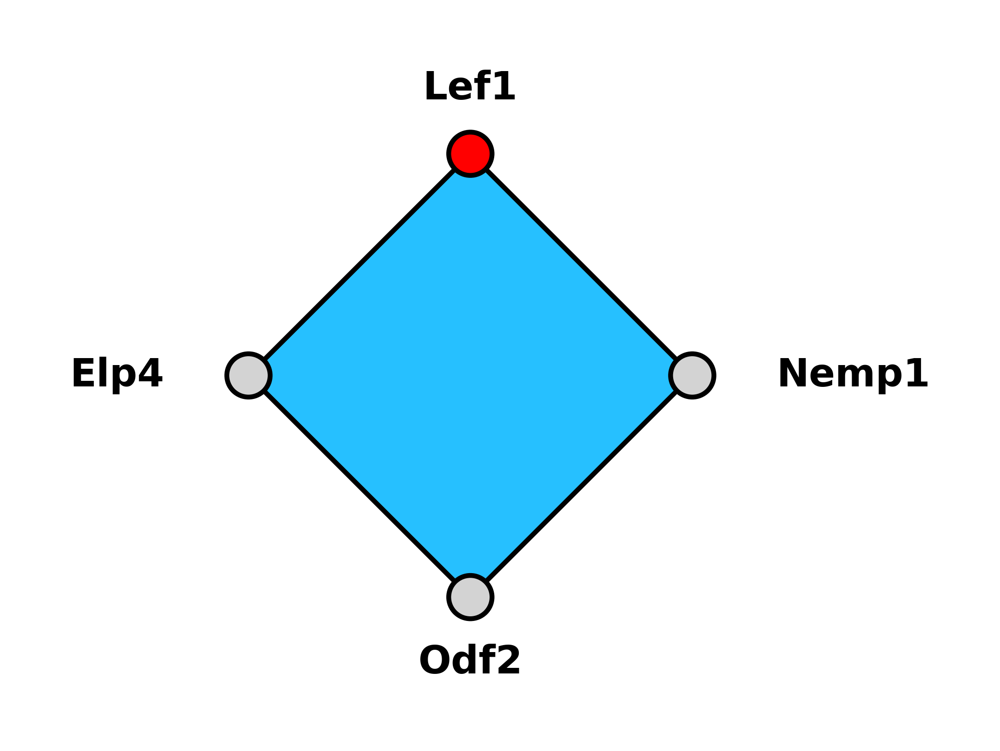

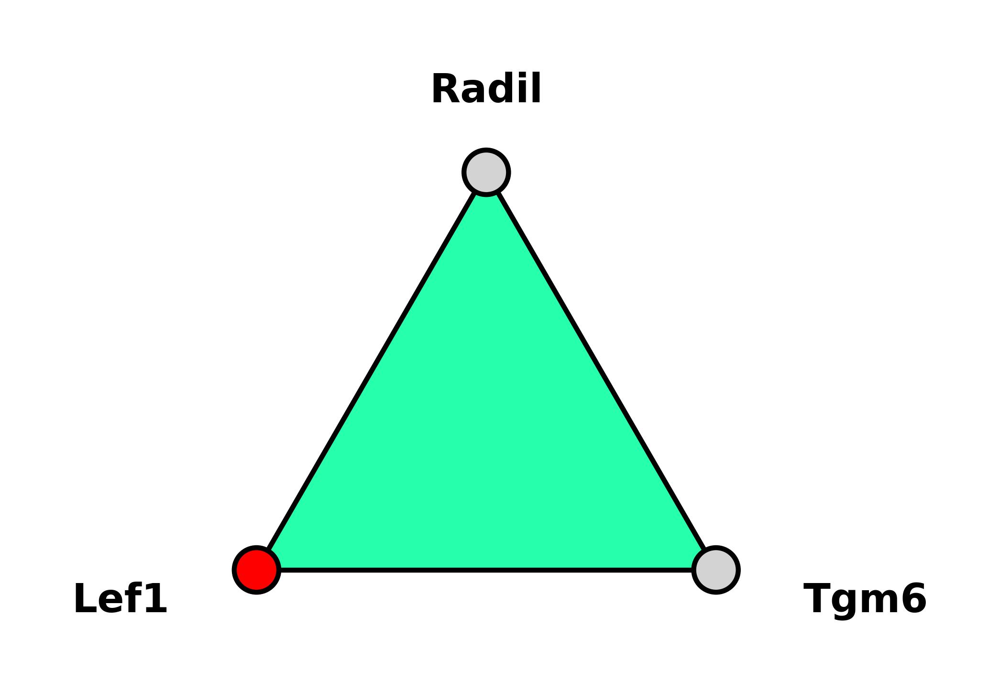

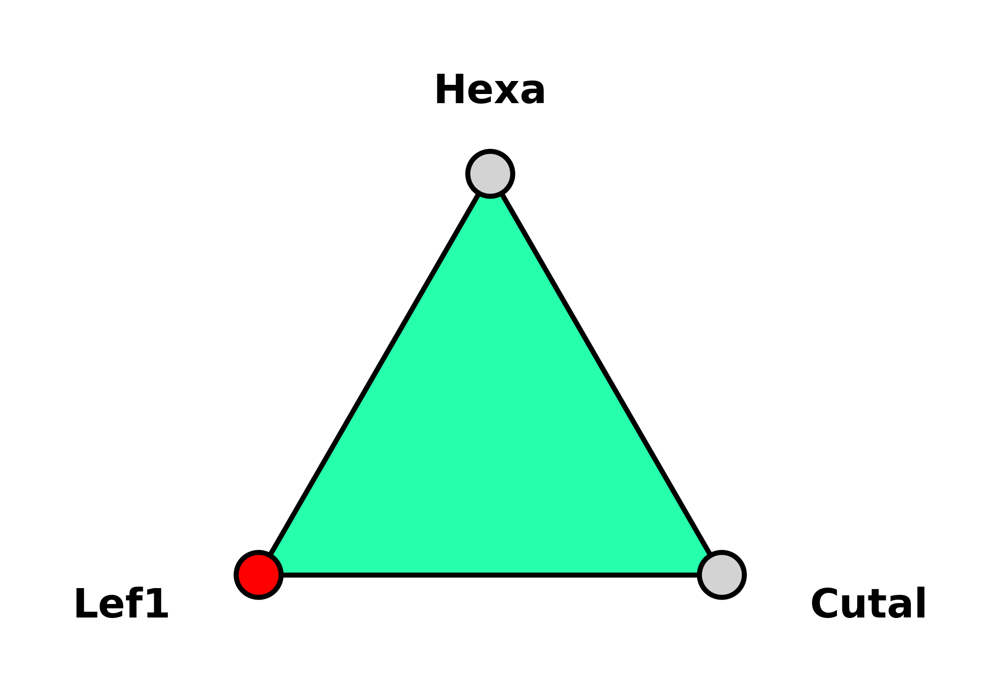

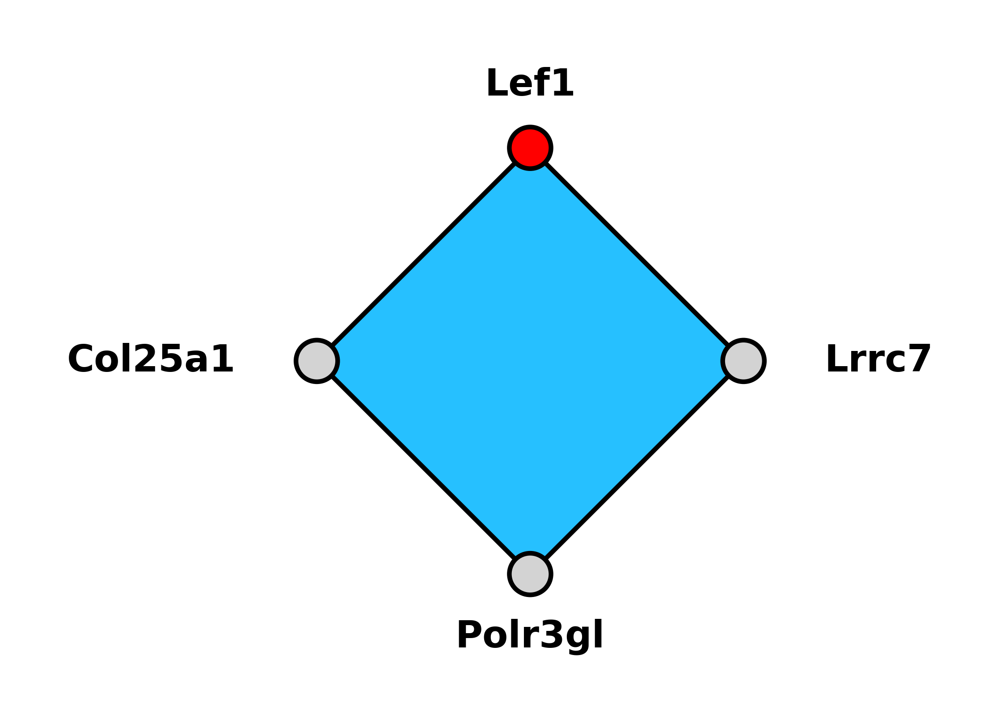

...

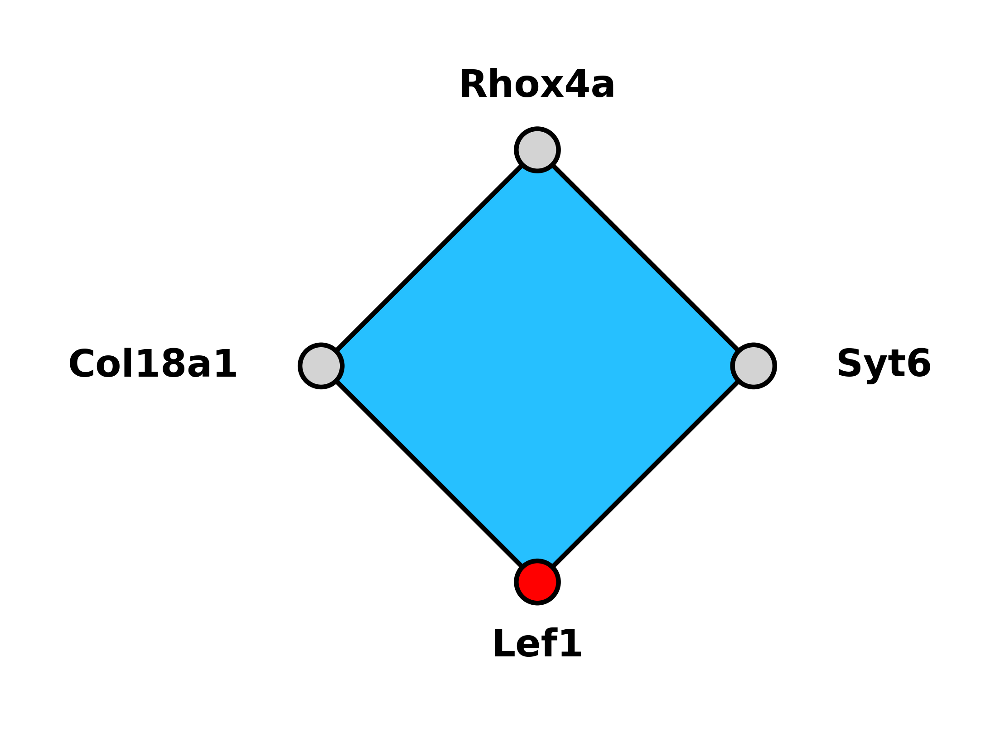

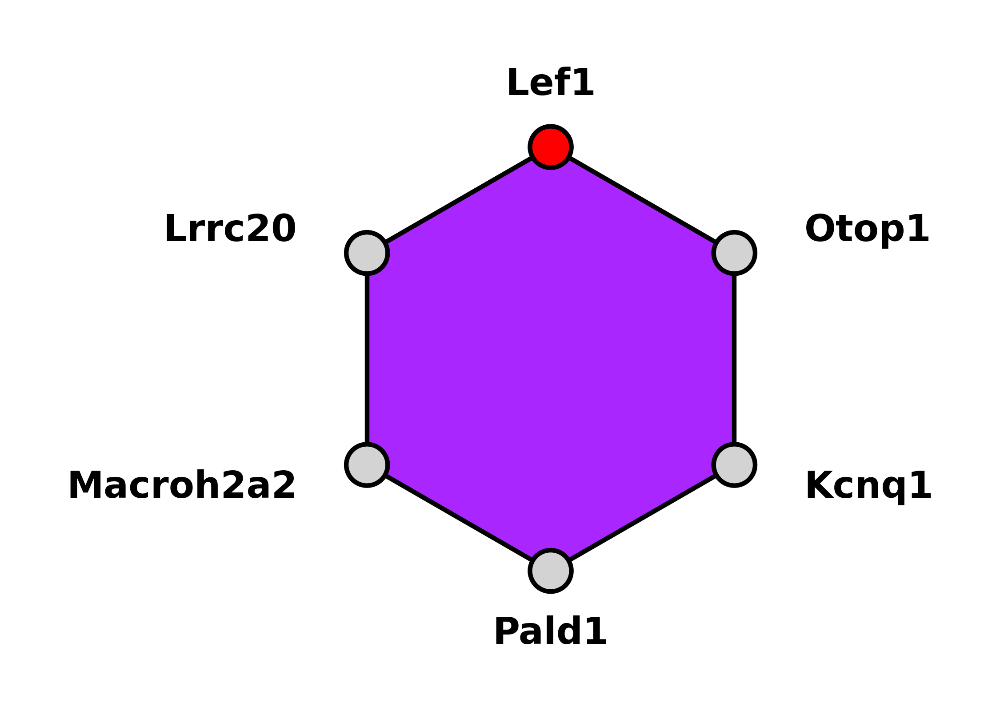

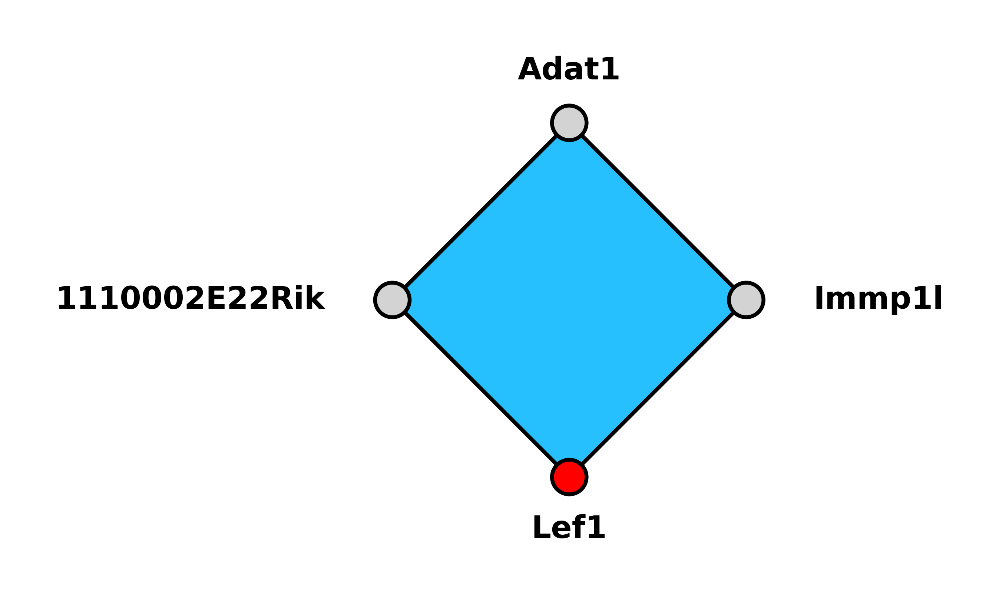

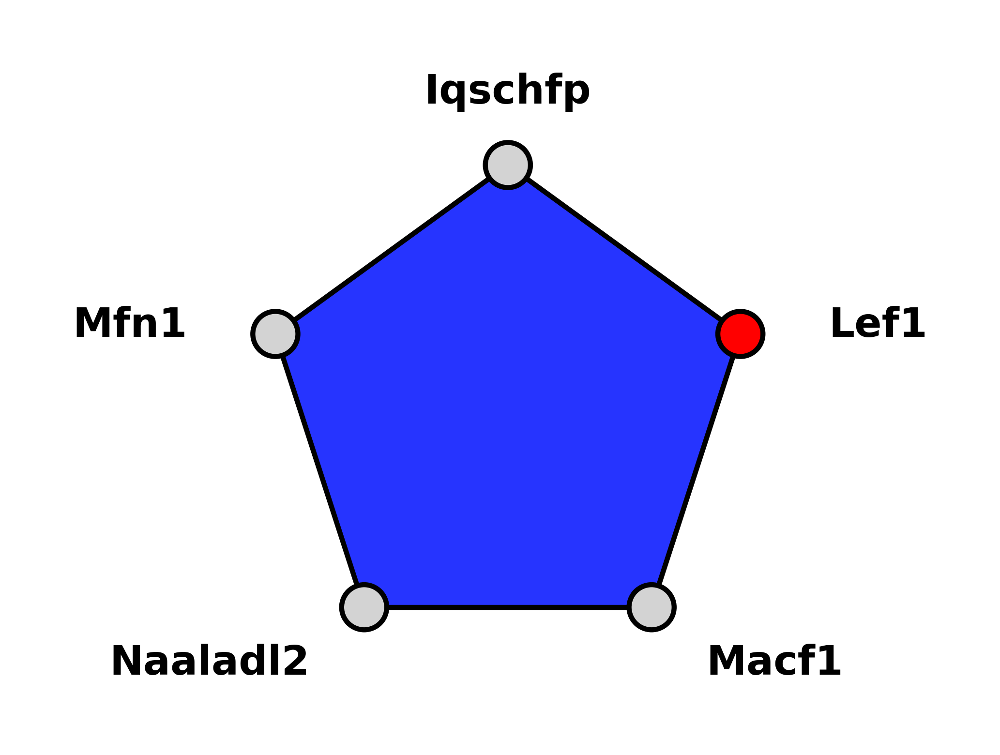

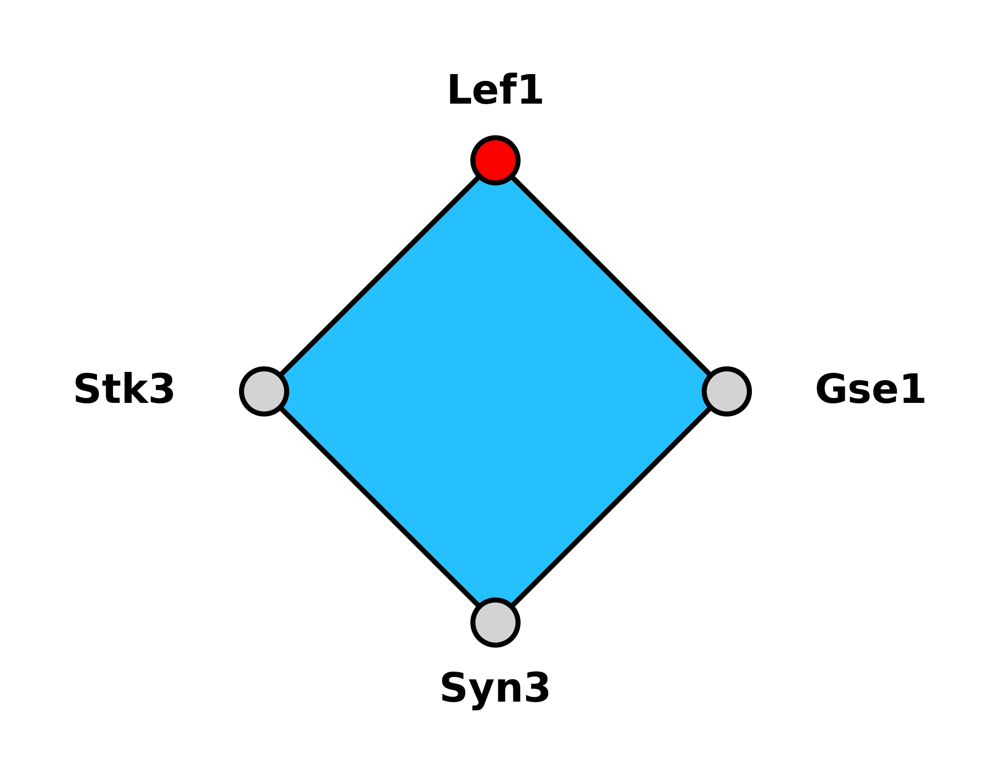

KeyError: 'Lef1'

In [176]:
def rotate_pos(graph, target_node):
  """
  Rotates a graph so that the target_node has the highest y-value.

  Args:
    graph: A dictionary with vertex names as keys and (x, y) 
           coordinates as values.
    target_node: The name of the node to have the highest y-value.

  Returns:
    A new dictionary with the same keys and rotated coordinates.
  """

  # 1. Calculate the center point
  center_x = sum(x for x, y in graph.values()) / len(graph)
  center_y = sum(y for x, y in graph.values()) / len(graph)

  # 2. Translate to origin
  translated_graph = {
      node: (x - center_x, y - center_y) for node, (x, y) in graph.items()
  }

  # 3.  Find the angle to rotate the target node to the positive y-axis
  target_x, target_y = translated_graph[target_node]
  angle = -math.atan2(target_x, target_y)  # Note the negative sign here

  # 4. Rotate all nodes
  rotated_graph = {}
  for node, (x, y) in translated_graph.items():
    rotated_x = x * math.cos(angle) - y * math.sin(angle)
    rotated_y = x * math.sin(angle) + y * math.cos(angle)
    rotated_graph[node] = (rotated_x, rotated_y)

  # 5. Translate back
  final_graph = {
      node: (x + center_x, y + center_y) for node, (x, y) in rotated_graph.items()
  }

  return final_graph
    

def plot_hyperedge(
    group, target=tf, color='deepskyblue', 
    label_pad=0.38, linewidths=2.5, figsize=(5, 5),
):
    """Plot a hyperedge """

    node_list = group['gene_name'].values

    # build the graph
    G = nx.Graph()
    G.add_nodes_from(node_list)
    edges = [(node_list[i], node_list[(i+1)%len(node_list)]) for i in range(len(node_list))]
    G.add_edges_from(edges)
    G.pos = rotate_pos(nx.circular_layout(G), target)

    # node color
    node_color = np.where(group['is_tf'], 'r', 'lightgrey')

    plt.rcParams['figure.dpi'] = 300
    plt.rcParams['figure.figsize'] = figsize
    
    nx.draw_networkx_nodes(
        G, 
        G.pos,
        node_size=500,
        node_color=node_color,
        edgecolors='black', 
        linewidths=linewidths,      
    )

    polygon_coords = [G.pos[node] for node in node_list]
    polygon = patches.Polygon(
        polygon_coords, 
        closed=True, 
        facecolor=color, 
        edgecolor='none',
        alpha=0.85,
        zorder=0,
    )  
    plt.gca().add_patch(polygon)
    
    nx.draw_networkx_edges(
        G, 
        G.pos,
        width=linewidths,
        edge_color='k',
    )

    # Calculate the centroid of all node positions
    centroid_x = np.mean([x for x, y in G.pos.values()])
    centroid_y = np.mean([y for x, y in G.pos.values()])

    # Annotate each point with labels pointing away from the centroid
    for node, (x, y) in G.pos.items():
        # Calculate the angle from the centroid to the node
        angle = np.arctan2(y - centroid_y, x - centroid_x)

        # Adjust the text position to be slightly away from the node 
        # in the direction of the angle
        text_x = x + label_pad * np.cos(angle)
        text_y = y + label_pad * np.sin(angle)

        # Determine horizontal and vertical alignment based on node's 
        # position relative to the centroid
        tolerance = 0.01
        ha = 'center' if abs(x - centroid_x) <= tolerance else ('right' if x < centroid_x else 'left')
        va = 'center' if abs(y - centroid_y) <= tolerance else ('bottom' if y > centroid_y else 'top')

        plt.text(
            text_x, 
            text_y, 
            str(node), 
            fontsize=20, 
            fontweight='bold', 
            ha=ha, 
            va=va
        )

    
    sns.despine(bottom=True, left=True)
    plt.gca().invert_yaxis()
    plt.gca().set_aspect('equal')
    plt.show()
    

order_colors = plt2.get_n_colors(
    10, cmap_name='hsv',
)

order_colors = dict(zip(
    list(range(12)),
    order_colors[1:-1]
))

order_colors


for read_name, group in query.groupby('read_name'):
    if not len(group) in order_colors:
        continue

    color = order_colors[len(group)]
    plot_hyperedge(group, target=tf, color=color)
    # break

In [83]:
?nx.circular_layout

Signature: nx.circular_layout(G, scale=1, center=None, dim=2)
Docstring:
Position nodes on a circle.

Parameters
----------
G : NetworkX graph or list of nodes
    A position will be assigned to every node in G.

scale : number (default: 1)
    Scale factor for positions.

center : array-like or None
    Coordinate pair around which to center the layout.

dim : int
    Dimension of layout.
    If dim>2, the remaining dimensions are set to zero
    in the returned positions.
    If dim<2, a ValueError is raised.

Returns
-------
pos : dict
    A dictionary of positions keyed by node

Raises
------
ValueError
    If dim < 2

Examples
--------
>>> G = nx.path_graph(4)
>>> pos = nx.circular_layout(G)

Notes
-----
This algorithm currently only works in two dimensions and does not
try to minimize edge crossings.
File:      ~/miniconda3/envs/scanpy/lib/python3.12/site-packages/networkx/drawing/layout.py
Type:      function

Found 7 reads of 3 for Esrrb


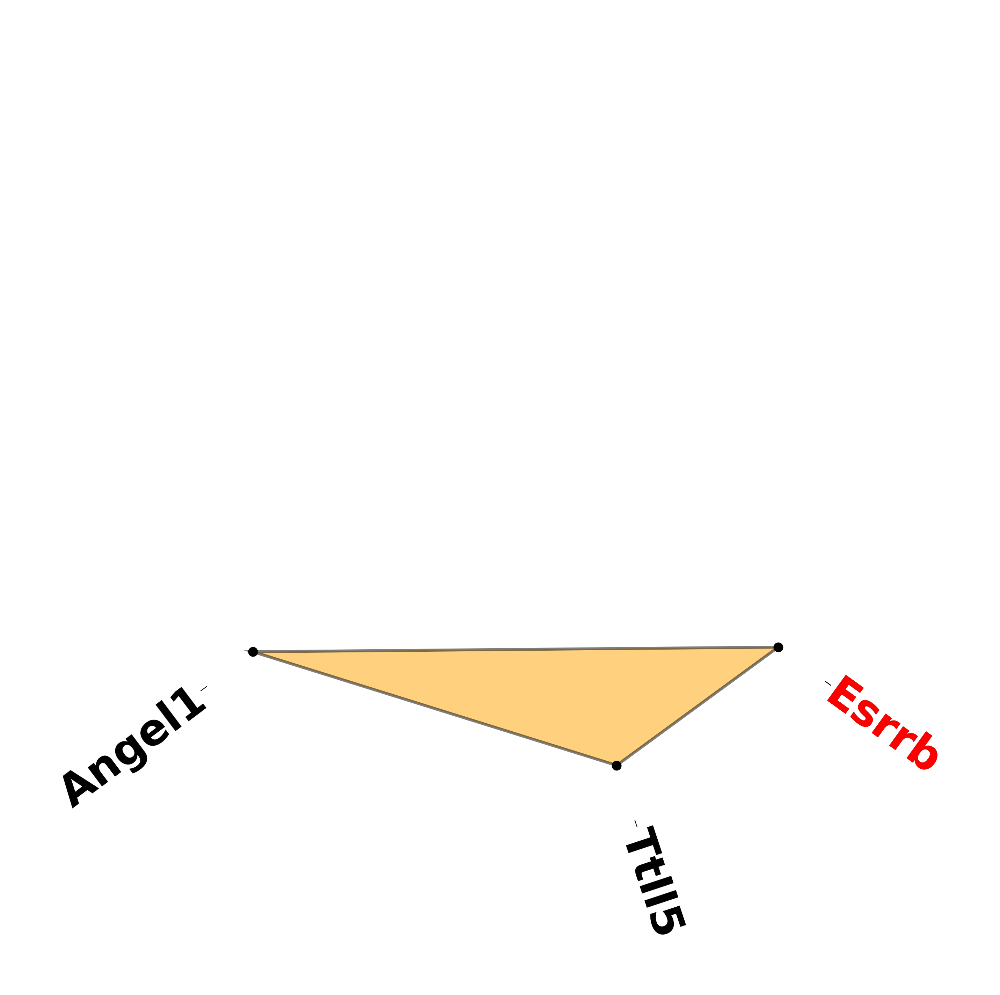

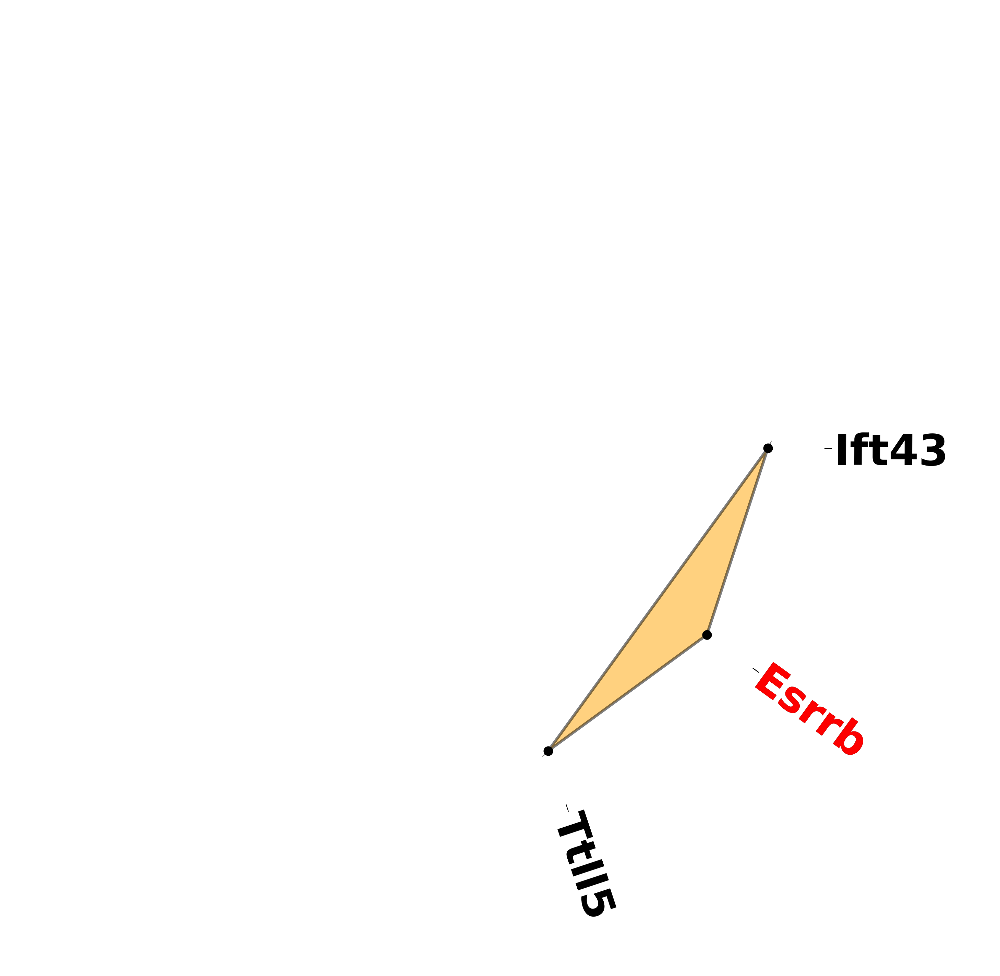

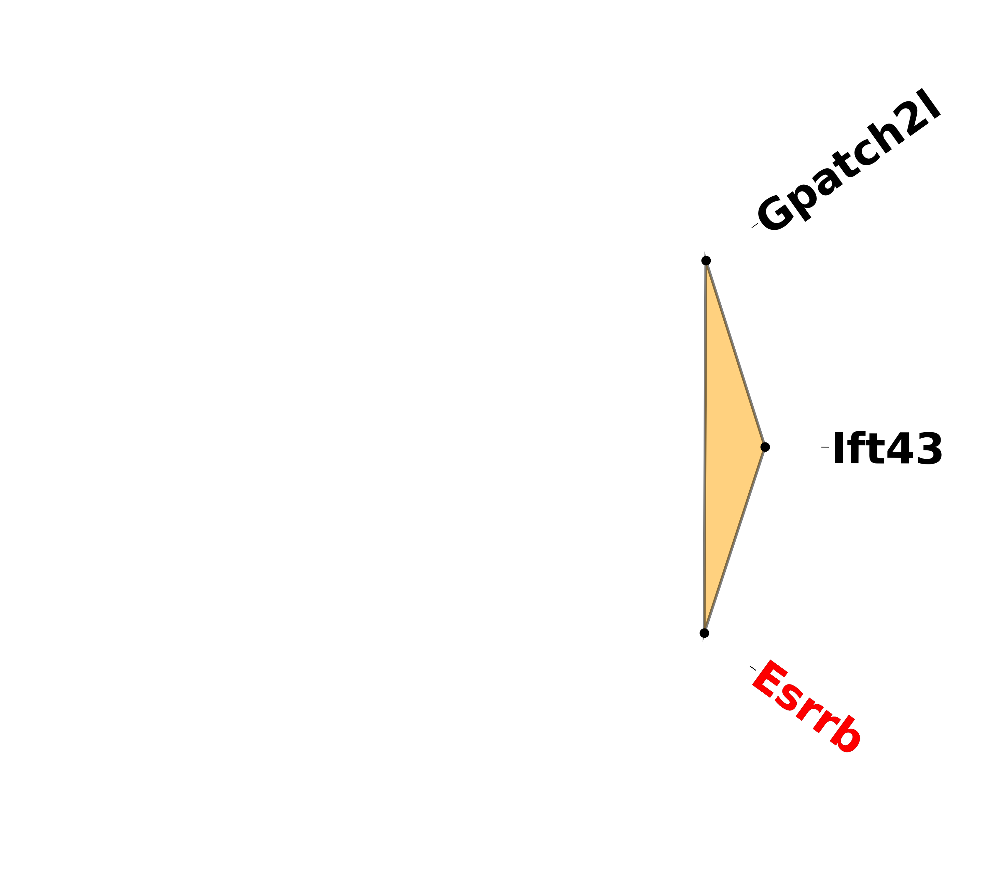

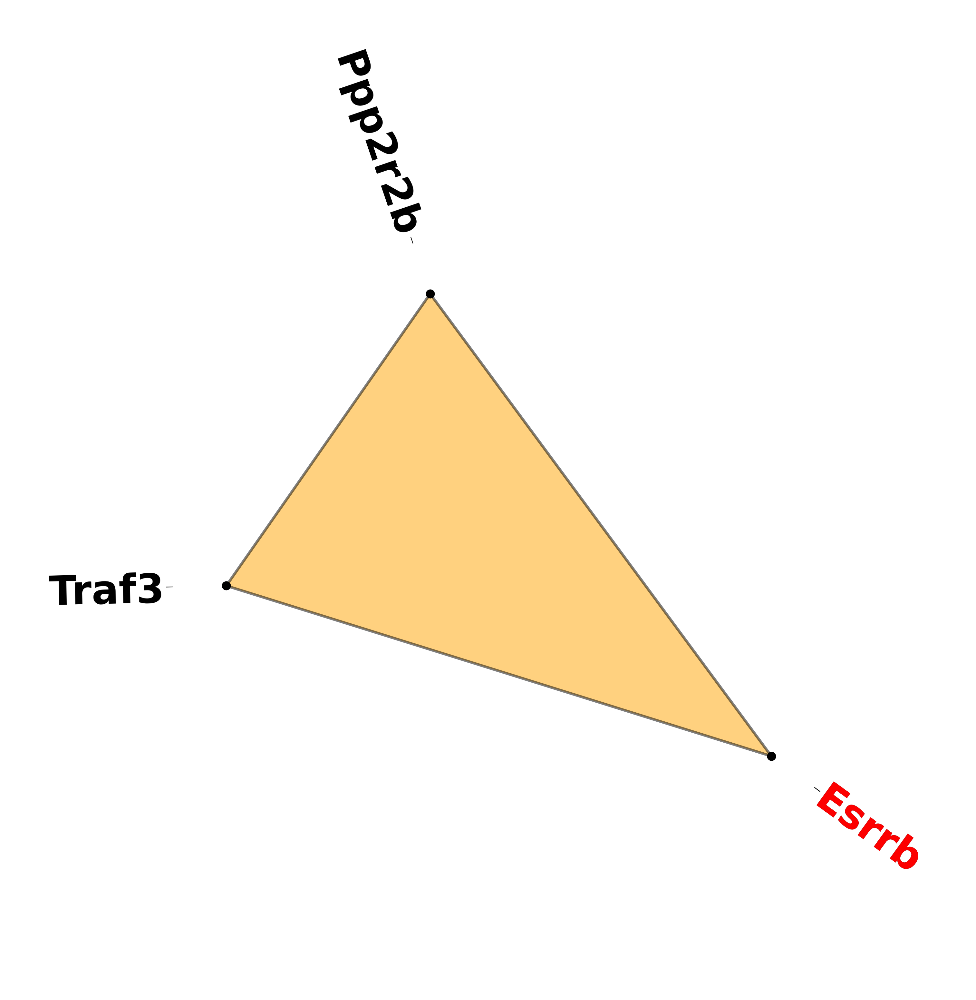

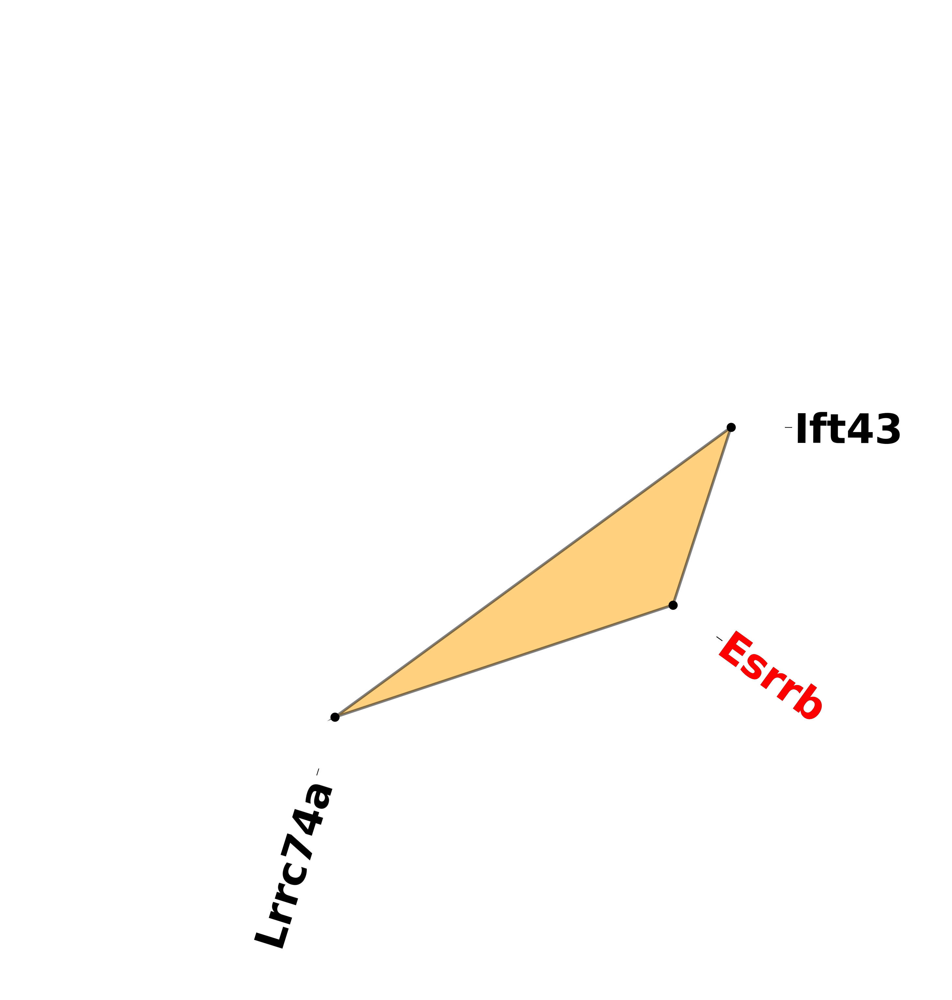

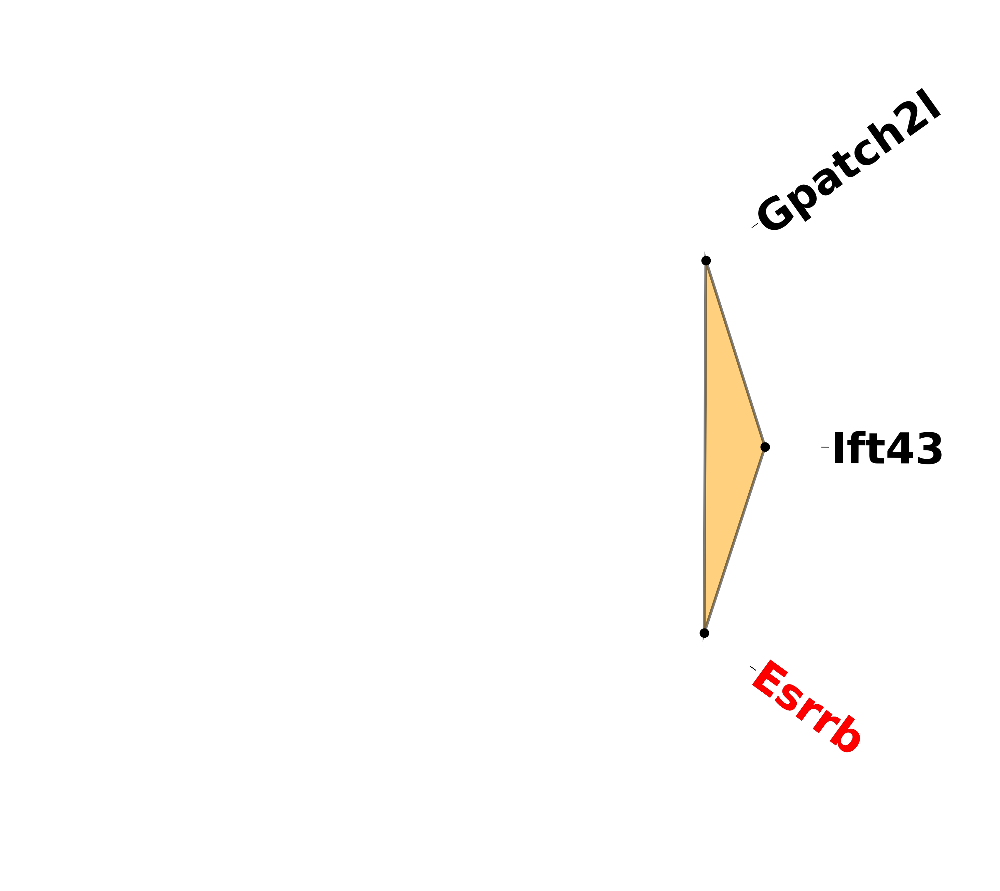

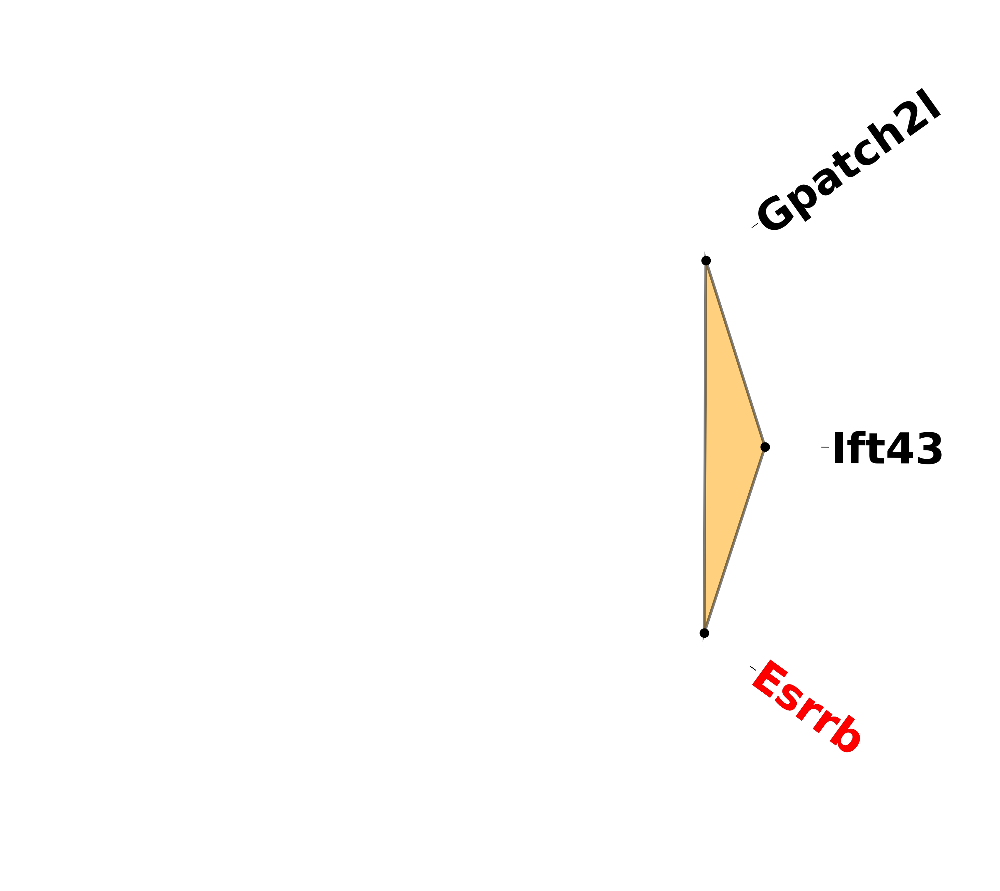

In [59]:
order = 3
color = 'orange'


filtered_query = query[query['query_order'] == order]
if not len(filtered_query) > 0:
    raise ValueError(f"No interactions of {order} for {tf}!")
else:
    n_plot = filtered_query['read_name'].nunique()
    print(f"Found {n_plot} reads of {order} for {tf}")


for read_name, group in filtered_query.groupby('read_name'):
    plt.rcParams['figure.dpi'] = 300
    plt.rcParams['figure.figsize'] = 10, 10
    fig = plt.figure(facecolor='none')
    ax = fig.add_subplot(111, polar=True)

    circos, gene_dict = plot_circos(
        ax, 
        query, 
        fontsize=30,
        label_chroms=False,
        plot_chrom_blocks=False, 
        label_genes=False,
        pad=0.25,
        chrom_cmap='tab20c',
    )

    node_list = group['gene_name'].values

    """ RESET axis ticks """

    for chrom, chrom_group in group.groupby('chrom'):
        chrom_group = chrom_group.reset_index()
        sector = circos.get_sector(chrom)
        track = sector.get_track('chrom_block')

        labels = chrom_group['gene_name'].values
        xticks = np.asarray([gene_dict[x]['position'] for x in labels])
     
        track.xticks(
            x = xticks,
            labels = labels,
            label_orientation='vertical',
            label_size=30,
            text_kws={'color' : 'k', 'fontweight' : 'bold'},
        )

        # any TFs?
        tfs = chrom_group[chrom_group['is_tf']]
        if not tfs.empty:
            tf_indices = np.asarray(tfs.index)
            tf_labels = tfs['gene_name'].values
            tf_ticks = xticks[tf_indices]
            
            track.xticks(
                x = tf_ticks,
                labels = tf_labels,
                label_orientation='vertical',
                label_size=30,
                text_kws={'color' : 'r', 'fontweight' : 'bold'},
            )

    """ PLOT the polygons """
    polygon_coords = np.asarray([node_to_coord(x, gene_dict=gene_dict, circos=circos) for x in node_list])
    
    poly = patches.Polygon(
        polygon_coords, 
        closed=True, 
        alpha=0.5, 
        facecolor=color,
        ec='k',
        linewidth=2,
        zorder=30,
    )  
    
    ax.add_patch(poly)

    ax.scatter(
        polygon_coords[:, 0],
        polygon_coords[:, 1],
        zorder=55,
        c='k',
        s=45,
        marker='o'
    )
    
    fig = circos.plotfig(
        ax=ax,
    )

    # break
    plt.show()

In [ ]:
break

# Legacy

In [ ]:
pad = 0.25

""" STRUCTURE the gene metadata """
genes = query[['gene_name', 'is_tf', 'is_core', 'chrom', 'val']].drop_duplicates()
genes['gene_position'] = genes.groupby('chrom', sort=False).cumcount() + 0.5
gene_dict = genes.set_index('gene_name').to_dict(orient='index')

sectors = genes.groupby('chrom', sort=False)['gene_name'].count()

""" ESTABLISH colors """
chrom_colors = plt2.get_n_colors(
    len(sectors) + 2, 
    cmap_name='tab20c',
)

chrom_colors = dict(zip(
    genes['chrom'].unique(),
    chrom_colors[1:-1]
))

read_colors = plt2.get_n_colors(query['read_name'].nunique(), cmap_name='hsv')
read_colors = dict(zip(
    query['read_name'].unique(),
    read_colors,
))


""" BUILD circos """
circos = Circos(sectors, space=2)
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 10, 10
fig = plt.figure()
ax = fig.add_subplot(111, polar=True)
""" ADD chromosome track """
for i, sector in enumerate(circos.sectors):

    """ADD chromosome blocks """
    track = sector.add_track((91, 100))
    chrom = sector.name
    track.axis(
        fc=chrom_colors[chrom],
    )
    track.text(
        chrom.replace("chr",""), 
        fontweight='bold',
        fontsize=12,
        adjust_rotation=False,
    )

    chrom_data = genes[genes['chrom'] == chrom].reset_index()
    
    xticks = chrom_data['gene_position'].values
    labels = chrom_data['gene_name'].values

    track.xticks(
        x = xticks,
        labels = labels,
        label_orientation='vertical',
        label_size=12,
        text_kws={'color' : 'k', 'fontweight' : 'bold'},
    )

    # any TFs?
    tfs = chrom_data[chrom_data['is_tf']]
    if not tfs.empty:
        tf_indices = np.asarray(tfs.index)
        tf_labels = tfs['gene_name'].values
        tf_ticks = xticks[tf_indices]
        
        track.xticks(
            x = tf_ticks,
            labels = tf_labels,
            label_orientation='vertical',
            label_size=12,
            text_kws={'color' : 'r', 'fontweight' : 'bold'},
        )

    # # add boxes
    # track = sector.add_track((87, 90))
    # for gene in xticks:
    #     track.rect(gene-pad, gene+pad, fc='grey')


def node_to_coord(node, gene_dict=gene_dict, circos=circos):
    """a function that accepts a gene name and returns
    the polar coordinate of on the circos plot """
    d = gene_dict[node]
    chromosome = d['chrom']
    position = d['gene_position'] 
    sector = circos.get_sector(chromosome)
    r = sector.get_lowest_r()
    x = sector.x_to_rad(position)
    return x, r
    

for read_name, group in query.groupby('read_name'):
    # get color 
    color =  read_colors[read_name]

    # get nodes
    node_list = group['gene_name'].values
    polygon_coords = np.asarray([node_to_coord(x) for x in node_list])

    poly = patches.Polygon(
        polygon_coords, 
        closed=True, 
        alpha=0.5, 
        facecolor=color,
        ec='k',
        linewidth=2,
        zorder=30,
    )  

    ax.add_patch(poly)

    ax.scatter(
        polygon_coords[:, 0],
        polygon_coords[:, 1],
        zorder=35,
        c='k',
        s=35,
        marker='s'
    )

    break
    

fig = circos.plotfig(
    ax=ax,
)


In [ ]:
break

In [ ]:
?track.xticks

In [ ]:
""" STRUCTURE the gene metadata """
genes = query[['gene_name', 'is_tf', 'is_core', 'chrom', 'val']].drop_duplicates()
gene_dict = genes.set_index('gene_name').to_dict(orient='index')

""" ESTABLISH colors """
chrom_colors = plt2.get_n_colors(
    genes['chrom'].nunique() + 2, 
    cmap_name='tab20c',
)

chrom_colors = dict(zip(
    genes['chrom'].unique(),
    chrom_colors[1:-1]
))


""" ESTABLISH sectors """
sectors = genes.groupby('gene_name', sort=False)['val'].count()

""" BUILD circos """
circos = Circos(sectors, space=0.0)
""" ADD chromosome track """
for i, sector in enumerate(circos.sectors):
    track = sector.add_track((91, 100))

    color = 'k'
    if gene_dict[sector.name]['is_tf']:
        color = 'deepskyblue'
    if sector.name == tf:
        color = 'r'

    track.text(
        sector.name, 
        color=color, 
        fontweight='bold',
        fontsize=12,
        orientation='vertical',
    )

    """ADD chromosome blocks """
    track = sector.add_track((76, 83))
    chrom = gene_dict[sector.name]['chrom']
    track.axis(
        fc=chrom_colors[chrom],
        # alpha=0.5,
    )

    track.text(
        chrom.replace("chr", ""),
        color='k',
        fontsize=12,
        adjust_rotation=False,
    )



fig = circos.plotfig(
    dpi=300,
    figsize=(10, 10)
)


In [ ]:
""" STRUCTURE the gene metadata """
genes = query[['gene_name', 'is_tf', 'is_core', 'chrom', 'val']].drop_duplicates()
gene_dict = genes.set_index('gene_name').to_dict(orient='index')

""" ESTABLISH colors """
chrom_colors = plt2.get_n_colors(
    genes['chrom'].nunique() + 2, 
    cmap_name='tab20c',
)

chrom_colors = dict(zip(
    genes['chrom'].unique(),
    chrom_colors[1:-1]
))

""" SET up the metedata """
# get higher-order interactions
interactions = query.groupby('read_name')['gene_name'].apply(list).reset_index()

# get the total number of gene pairs each gene is involved in
H = pd.pivot_table(
    query, 
    index='read_name', 
    columns='gene_name',
    values='val',
    fill_value=0.0
)

# quick clique-expansion for vis purposes only
A = (H.T @ H)
np.fill_diagonal(A.values, 0)
A = pd.DataFrame(A, index=H.columns)
n_pairs = A.sum().to_dict()

""" ESTABLISH sectors """
sectors = genes.groupby('gene_name', sort=False)['val'].count()

""" BUILD circos """
circos = Circos(sectors, space=0.0)
""" ADD chromosome track """
for i, sector in enumerate(circos.sectors):
    track = sector.add_track((91, 100))

    color = 'k'
    if gene_dict[sector.name]['is_tf']:
        color = 'deepskyblue'
    if sector.name == tf:
        color = 'r'

    track.text(
        sector.name, 
        color=color, 
        fontweight='bold',
        fontsize=12,
        orientation='vertical',
    )

    """ADD chromosome blocks """
    track = sector.add_track((76, 83))
    chrom = gene_dict[sector.name]['chrom']
    track.axis(
        fc=chrom_colors[chrom],
        # alpha=0.5,
    )

    track.text(
        chrom.replace("chr", ""),
        color='k',
        fontsize=12,
        adjust_rotation=False,
    )



fig = circos.plotfig(
    dpi=300,
    figsize=(10, 10)
)


In [ ]:
break

In [ ]:
dir(circos)

In [ ]:
dir(circos)

In [ ]:
""" STRUCTURE the gene metadata """
genes = query[['gene_name', 'is_tf', 'is_core', 'chrom', 'val']].drop_duplicates()
genes['gene_position'] = genes.groupby('chrom', sort=False).cumcount() + 1
# Normalize gene positions to 0-1 range within each chromosome
genes['gene_position_normalized'] = genes.groupby('chrom')['gene_position'].transform(
    lambda x: (x - 1) / (len(x) - 1)
)
print(f"{genes.shape=}")

""" SET up the metedata """
# get higher-order interactions
interactions = query.groupby('read_name')['gene_name'].apply(list).reset_index()

# get the total number of gene pairs each gene is involved in
H = pd.pivot_table(
    query, 
    index='read_name', 
    columns='gene_name',
    values='val',
    fill_value=0.0
)

# quick clique-expansion for vis purposes only
A = (H.T @ H)
np.fill_diagonal(A.values, 0)
A = pd.DataFrame(A, index=H.columns)
n_pairs = A.sum().to_dict()

genes['n_pairs'] = genes['gene_name'].map(n_pairs)

""" ESTABLISH sectors """
sectors = genes.groupby('chrom', sort=False)['gene_name'].count()
# genes_per_sector = genes.groupby('chrom', sort=False)['gene_name'].count()


""" ESTABLISH colors """
chrom_colors = plt2.get_n_colors(
    genes['chrom'].nunique() + 2, 
    cmap_name='nipy_spectral',
)

chrom_colors = dict(zip(
    sorted(genes['chrom'].unique()),
    chrom_colors[1:-1]
))

# read_colors = plt2.get_n_colors(query['read_name'].nunique(), cmap_name='turbo')
# read_colors = dict(zip(
#     query['read_name'].unique(),
#     read_colors,
# ))


""" BUILD circos """
circos = Circos(sectors, space=2)
""" ADD chromosome track """
for i, sector in enumerate(circos.sectors):
    track = sector.add_track((71, 80))
    
    track.axis(
        fc=chrom_colors[sector.name], 
        ec='k',
        alpha=0.75,
    )
    track.text(
        sector.name.replace("chr", ""), 
        color='k', 
        fontweight='bold',
        fontsize=12,
        adjust_rotation=False,
    )

    track.xticks(
        x = genes[genes['chrom'] == sector.name]['gene_position'].values - 0.5,
        labels = genes[genes['chrom'] == sector.name]['gene_name'].values,
        label_orientation='vertical',
    )

    # track.xticks_by_interval(1)
    gene_track = sector.add_track((65, 70))

    for _, row in genes[genes['chrom'] == sector.name].iterrows():
        gene_track.rect(
            (row['gene_position'] - 1, 
            row['gene_position'],
        )

    
    # rect_size = 10
    # for i in range(int(rect_track.size / rect_size)):
    #     x1, x2 = i * rect_size, i * rect_size + rect_size
    #     rect_track.rect(x1, x2, ec="black", lw=0.5, color='k')
    #     rect_track.text(str(i + 1), (x1 + x2) / 2, size=8, color="white")


    
fig = circos.plotfig(
    dpi=300,
    figsize=(10, 10)
)

In [ ]:
?track.xticks

In [ ]:
sectors

In [ ]:
genes

In [ ]:
""" STRUCTURE the gene metadata """
genes = query[['gene_name', 'is_tf', 'is_core', 'chrom', 'val']].drop_duplicates()
genes['gene_position'] = genes.groupby('chrom', sort=False).cumcount() + 1
print(f"{genes.shape=}")

gene_dict = genes.set_index('gene_name').to_dict(orient='index')


""" ESTABLISH sectors """
sectors = chroms

""" ESTABLISH colors """
chrom_colors = plt2.get_n_colors(
    genes['chrom'].nunique() + 2, 
    cmap_name='nipy_spectral',
)

chrom_colors = dict(zip(
    sorted(genes['chrom'].unique()),
    chrom_colors[1:-1]
))

read_colors = plt2.get_n_colors(query['read_name'].nunique(), cmap_name='turbo')
read_colors = dict(zip(
    query['read_name'].unique(),
    read_colors,
))

""" BUILD reference data structures """
# get the higher order interactions
interactions = query.groupby('read_name')['gene_name'].apply(list).reset_index()

# get the total number of gene pairs each gene is involved in
H = pd.pivot_table(
    query, 
    index='read_name', 
    columns='gene_name',
    values='val',
    fill_value=0.0
)

# quick clique-expansion for vis purposes only
A = (H.T @ H)
np.fill_diagonal(A.values, 0)
A = pd.DataFrame(A, index=H.columns)
n_pairs = A.sum().to_dict()


""" BUILD circos """
circos = Circos(sectors, space=0.25)
for i, sector in enumerate(circos.sectors):
    """ ADD chromosome track """
    track = sector.add_track((71, 80))
    track.axis(
        fc=chrom_colors[sector.name], 
        ec='k',
        alpha=0.75,
    )
    track.text(
        sector.name.replace("chr", ""), 
        color='k', 
        fontweight='bold',
        fontsize=12,
        adjust_rotation=False,
    )

    """ ADD gene track """
    for _, row in genes[genes['chrom'] == sector.name].iterrows():
        track = sector.add_track((61, 70))
        track.rect(row['gene_position'], row['gene_position'] + 1) 


    
    # chrom = gene_dict[sector.name]['chrom']

    # # add gene blocks
    # color = 'k'
    # if gene_dict[sector.name]['is_tf']:
    #     color = 'deepskyblue'
    # if sector.name == tf:
    #     color = 'red'
        
    # track = sector.add_track((85, 100))
    # track.axis(
    #     fc='none',
    #     ec='none',
    # )
    # track.text(
    #     sector.name.strip(), 
    #     color=color, 
    #     fontweight='bold',
    #     fontsize=12,
    #     orientation='vertical',
    # )

    # # add chromosome track
    # if chrom != last_chrom:
    #     if chrom_counter:
    #         facecolor = 'k'
    #         textcolor = 'w'
    #     else:
    #         facecolor = 'w'
    #         textcolor = 'k'
        
    #     chrom_counter = not chrom_counter
    #     last_chrom = chrom
        
    # track = sector.add_track((71, 80))
    # track.axis(
    #     fc=facecolor, 
    #     ec='k',
    #     alpha=0.75,
    # )

    # track.text(
    #     chrom.replace("chr", ""), 
    #     color=textcolor, 
    #     fontweight='bold',
    #     fontsize=12,
    #     adjust_rotation=False,
    # )

    # track = sector.add_track((68, 70))
    # track.axis(
    #     fc='k', 
    #     ec='k',
    #     alpha=0.75,
    # )

# """ PLOT interactions """

# # a datastructure to track the number of interactions each gene is involved in
# gene_ticker = dict(zip(genes['gene_name'].values, np.zeros(len(genes))))

# for _, row in interactions.iterrows():
#     read_name = row['read_name']
#     node_list = row['gene_name']
#     pairs = list(combinations(node_list, 2))

#     for i, j in pairs:
#         i_intervals = list(np.linspace(0, 1, n_pairs[i] + 1))
#         j_intervals = list(np.linspace(0, 1, n_pairs[j] + 1))

#         i_current = int(gene_ticker[i])
#         j_current = int(gene_ticker[j])

#         i_lb = i_intervals[i_current]
#         i_ub = i_intervals[i_current + 1]
        
#         j_lb = j_intervals[j_current]
#         j_ub = j_intervals[j_current + 1]

#         gene_ticker[i] += 1
#         gene_ticker[j] += 1

#         circos.link(
#             (i, i_lb , i_ub), 
#             (j, j_lb , j_ub),  
#             color=read_colors[read_name], 
#             lw=0.0, 
#             height_ratio=0.15,
#             alpha=0.5, 
#             allow_twist=False,
#         )
    
fig = circos.plotfig(
    dpi=300,
    figsize=(10, 10)
)

In [ ]:
genes

In [ ]:
.count()

In [ ]:
read_colors = plt2.get_n_colors(query['read_name'].nunique(), cmap_name='Set1')
read_colors = dict(zip(
    query['read_name'].unique(),
    read_colors,
))

read_colors

In [ ]:
query.groupby('gene_name')['read_name'].count()

# gene_counts = 

In [ ]:
ene_counts = 

# Archive

In [ ]:
break

In [ ]:
# tf = "Sox5"
# tf = "Hivep3"
tf = "Msi2"

biotype = 'protein_coding'
core_only = True
order_threshold = 2

query = gdata.copy()

# drop predicted genes
query = query[~query.obs.index.str.startswith('Gm'), :].copy()
query = query[query.obs['gene_biotype'] == biotype, :].copy()
if core_only:
    query = query[query.obs['is_core'], :].copy()

bin_map = dict(zip(adata.obs.index, adata.obs['bin']))

# Get the row corresponding to the obs_index
row_data = query[tf, :].X.todense()

# Find columns where the row data is 1 and the column sum is greater than n
mask = (row_data == 1) & (query.X.sum(axis=0) > order_threshold)

# Slice the AnnData object using the valid columns
query = query[:, mask].copy()
query = query[query.X.sum(axis=1) > 0, :].copy() # only consider genes that are seen in n contacts

# add the global bin ids and sort
query.obs['bin'] = query.obs['bin_name'].map(bin_map)
sorted_indices = query.obs['bin'].argsort()
query = query[sorted_indices, :].copy()

matrix.expand_and_normalize_anndata(query)

query

In [ ]:
edge_list = pd.melt(
    query.obsm['A'].reset_index(), id_vars='index',
)

edge_list.columns = ['gene_i', 'gene_j', 'weight']
edge_list = edge_list[edge_list['gene_i'] != edge_list['gene_j']] # drop the diagonal
edge_list = edge_list[edge_list['weight'] > 0]

print(f"{edge_list.shape=}")
edge_list = edge_list.sort_values(by='weight', ascending=False)
edge_list['norm_weight'] = ut.min_max(edge_list['weight'])
edge_list.head()

In [ ]:
sectors = dict(zip(
    query.obs_names, 
    [1] * len(query.obs_names),
))

chrom_colors = colors = plt2.get_n_colors(
    query.obs['chrom'].nunique() + 2, 
    cmap_name='nipy_spectral',
)

chrom_colors = dict(zip(
    query.obs['chrom'].unique(),
    chrom_colors[1:-1]
))

circos = Circos(sectors, space=0.25)

for i, sector in enumerate(circos.sectors):    
    meta = query.obs.iloc[i]
    chrom = meta['chrom']

    # add chromosome track
    track = sector.add_track((91, 100))
    track.axis(
        fc=chrom_colors[chrom], 
        ec='none',
    )

    track.text(
        chrom.replace("chr", ""), 
        color="k", 
        fontweight='bold',
        fontsize=12,
    )

    # add gene blocks
    color = 'lightgrey'
    if meta['is_tf']:
        color = 'deepskyblue'
    if sector.name == tf:
        color = 'orange'
    track = sector.add_track((71, 90))
    track.axis(
        fc=color, 
    )
    track.text(
        sector.name, 
        color="k", 
        fontweight='bold',
        fontsize=8,
        orientation='vertical',
    )


for idx, row in edge_list.iterrows():    
    # print(row['norm_weight'])
    lb = ((1 - row['norm_weight']) / 2) + 0
    up = 1 - ((1 - row['norm_weight']) / 2) 
    
    circos.link(
        (row['gene_i'], lb, up), 
        (row['gene_j'], lb, up),  
        color='k', 
        lw=1, 
        height_ratio=0.2,
        alpha=0.25, 
        allow_twist=False,
    )          

fig = circos.plotfig(
    dpi=200,
    figsize=(10, 10)
)


In [ ]:
break

# Higher Order sturctures

In [ ]:
ho_interactions = query[:, query.to_df().sum() > 2].to_df()

sectors = dict(zip(
    query.obs_names, 
    [1] * len(query.obs_names),
))

chrom_colors = colors = plt2.get_n_colors(
    query.obs['chrom'].nunique() + 2, 
    cmap_name='nipy_spectral',
)

chrom_colors = dict(zip(
    query.obs['chrom'].unique(),
    chrom_colors[1:-1]
))

circos = Circos(sectors, space=0.25)

for i, sector in enumerate(circos.sectors):    
    meta = query.obs.iloc[i]
    chrom = meta['chrom']

    # add chromosome track
    track = sector.add_track((91, 100))
    track.axis(
        fc=chrom_colors[chrom], 
        ec='none',
    )

    track.text(
        chrom.replace("chr", ""), 
        color="k", 
        fontweight='bold',
        fontsize=12,
    )

    # add gene blocks
    color = 'lightgrey'
    if meta['is_tf']:
        color = 'deepskyblue'
    if sector.name == tf:
        color = 'orange'
    track = sector.add_track((71, 90))
    track.axis(
        fc=color, 
    )
    track.text(
        sector.name, 
        color="k", 
        fontweight='bold',
        fontsize=8,
        orientation='vertical',
    )


ho_interactions.T
for idx, row in ho_interactions.T.iterrows():
    nodes = row[row > 0]
    print(nodes)

    break
    


fig = circos.plotfig(
    dpi=200,
    figsize=(10, 10)
)


In [ ]:
?circos.link

In [ ]:
break

In [ ]:
query.to_df().sum(axis=1) > 0

# Archive

In [ ]:
break

In [ ]:
order = 3
H = gdata.to_df().T
H = H[H.sum(axis=1) >= order]
print(f"{H.shape=}")

def get_non_zero_cols(row):
  return ".".join(sorted(list(H.columns[row.astype(bool)])))

non_zero_cols = H.apply(get_non_zero_cols, axis=1).tolist()
top_interactions = pd.DataFrame(pd.Series(non_zero_cols).value_counts()).reset_index(names='hyperedge')
top_interactions.head(15)

In [ ]:
read_counts = pd.DataFrame(
    H.sum().reset_index(),
)

read_counts.columns =['gene_name', 'count']
read_counts['is_tf'] = read_counts['gene_name'].isin(tf_list)
read_counts = read_counts.sort_values(by='count', ascending=False)
read_counts = read_counts[read_counts['is_tf']]
read_counts.head(15)

In [ ]:
n_query = 15
database = 'ontology'
query = list(read_counts['gene_name'].head(n_query))

edf = gget.enrichr(query, database=database)
edf.head(15)

# Check out gene between chromosomes with high-inter chromosomal contacts

In [ ]:
order = 3
n_top = 3

chrom_pairs = [
    ('chr11', 'chr1'),	   # 2646 unique pairs, 5131 total contacts
    ('chr11', 'chr7'),	   # 2322 unique pairs, 4588 total contacts
    ('chr11', 'chr2'),	   # 2268 unique pairs, 4869 total contacts
    # ('chr7', 'chr1'),	   # 2107 unique pairs, 3603 total contacts
    ('chr11', 'chr8'),	   # 2106 unique pairs, 5039 total contacts
    # ('chr8', 'chr11'),	   # 2106 unique pairs, 5039 total contacts
    # ('chr1', 'chr2'),	   # 2058 unique pairs, 3678 total contacts
    # ('chr8', 'chr1'),	   # 1911 unique pairs, 3939 total contacts
    # ('chr5', 'chr1'),	   # 1911 unique pairs, 3575 total contacts
    # ('chr3', 'chr11'),	   # 1890 unique pairs, 3958 total contacts
]

result = []

for chrom_i, chrom_j in chrom_pairs:

    # find reads with mapped genes on both chromosomes
    i_data = gdata[gdata.obs['chrom'] == chrom_i, ].to_df().sum(axis=0) > 0
    i_reads = i_data[i_data].index

    j_data = gdata[gdata.obs['chrom'] == chrom_j, ].to_df().sum(axis=0) > 0
    j_reads = j_data[j_data].index

    # identify common reads
    common_reads = set(i_reads).intersection(set(j_reads))

    # extract hyperedges
    H = gdata[:, list(common_reads)].to_df().copy().T
    H = H[H.sum(axis=1) >= order]
    print(f"{chrom_i}-{chrom_j} {H.shape=}")

    if H.empty:
        continue

    H = H.apply(lambda x: list(H.columns[x.astype(bool)]), axis=1)
    H = pd.DataFrame(H, columns=['hyperedge'])
    H['chroms'] = f"{chrom_i}-{chrom_j}"
    result.append(H)

result = pd.concat(result)
print(f"{result.shape=}")

# id the reads that contain a TF
def check_list(lst):
  return any(elem in tf_list for elem in lst)
    
result['has_tf'] = result['hyperedge'].apply(check_list)
print(result['has_tf'].value_counts())

result.head()

In [ ]:
sample_size = 10

# plot the ones with a TF
pdf = result.copy()
# pdf = pdf[pdf['has_tf']]
pdf = pdf.reset_index(drop=False)
print(f"{pdf.shape=}")

pdf = pdf.sample(sample_size)
pdf = pdf.reset_index(drop=True)

for idx, row in pdf.iterrows():

    hyperedge = row['hyperedge']

    sns.pointplot(
        x=[idx] * len(hyperedge),
        y=hyperedge,
    )

    # break


pdf.head()

In [ ]:
gdata

In [ ]:
break

# Make an incidence matrix of protien coding genes

In [ ]:
n_genes = 50
min_gene_count = 75

# extract the reads with top TFs
genes = df[df['is_tf'] & df['is_core']]['gene_name'].value_counts().head(n_genes).index
genes = list(genes)
print(genes[:5])

read_names = df[df['gene_name'].isin(genes)]['read_name'].unique()

# use the full read for reads containing these TFs
reads = df[df['read_name'].isin(read_names)]
reads = reads[reads['gene_biotype'] == 'protein_coding']
reads = reads[~reads['gene_name'].str.startswith("Gm")] # drop predicted
reads = reads[~reads['gene_name'].str.endswith("Rik")] # drop predicted
print(f"(reads with top {n_genes} TFs:) {reads.shape=}")
print(f"(reads with top {n_genes} TFs:) {reads['gene_name'].nunique()=}")


# drop infrequently appearing genes
reads['gene_count'] = reads.groupby('gene_name')['read_name'].transform('nunique')
reads = reads[reads['gene_count'] > min_gene_count]

# drop reads with low-order 
reads['order'] = reads.groupby('read_name')['gene_name'].transform('nunique')
reads = reads[reads['order'] > 1]

print(f"(reads with top {n_genes} TFs and {min_gene_count}) {reads.shape=}")
print(f"(reads with top {n_genes} TFs and {min_gene_count}) {reads['gene_name'].nunique()=}")

reads = reads.sort_values(by='read_name')

reads.head()

In [ ]:
database = 'ontology'
query = list(reads['gene_name'].unique())

edf = gget.enrichr(query, database=database)
edf.head(15)

In [ ]:
gdata = make_gene_adata(reads)

# add obs
obs = reads.copy()
obs = obs.sort_values(by=['gene_name', 'is_core'], ascending=[False, False])
obs = obs.drop_duplicates(subset=['gene_name'])
obs = obs.set_index('gene_name')
obs = obs.reindex(gdata.obs_names)
gdata.obs = obs

gdata.obsm['A'] = gdata.X @ gdata.X.T 
gdata.obsm['A'] = pd.DataFrame.sparse.from_spmatrix(
    gdata.obsm['A'],
    index=gdata.obs_names,
    columns=gdata.obs_names,
)

gdata

# Network plots

In [ ]:
obsm_key = 'A'
edge_scale = 25

node_attributes = gdata.obs.copy()
node_attributes = node_attributes.to_dict(orient='index')

# define the graph
A = gdata.obsm[obsm_key].copy()
A = A.mask(np.eye(A.shape[0], dtype=bool), 0)
G = nx.from_pandas_adjacency(A)


nx.set_node_attributes(G, node_attributes)

G.pos = nx.spring_layout(
    G, 
    seed=32, k=0.5,
    iterations=100,
)
print(G)

node_colors = ['deepskyblue' if G.nodes[node]['is_tf'] else 'orange' for node in G.nodes]
node_sizes = np.log1p(ut.min_max(np.asarray([G.nodes[node]['gene_count'] for node in G.nodes])))
node_labels = [node for node in G.nodes]

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 10, 10

# nx.draw_networkx_nodes(
#     G, 
#     G.pos,
#     node_size=node_sizes*1200,
#     node_color=node_colors,
#     edgecolors='black', 
#     linewidths=0.5,      
# )

for node in G.nodes:
    node_attr = G.nodes[node]
    
    node_color = 'k'
    facecolor = 'lightgrey'
    if node_attr['is_tf']:
        node_color = 'blue'

    if node_attr['is_core']:
        facecolor = 'lightcoral'

    nx.draw_networkx_labels(
        G,
        G.pos,
        labels={node: node},
        font_size=8,
        font_color=node_color,
        font_weight='bold',
        bbox=dict(facecolor=facecolor, edgecolor='k', lw=0.5)
    )

edge_widths = np.asarray([(d['weight']) for u, v, d in G.edges(data=True)])
edge_widths = np.sqrt(ut.min_max(edge_widths) * edge_scale)

nx.draw_networkx_edges(
    G, 
    G.pos,
    width=edge_widths,
    edge_color='k',
    alpha=0.5,
)

# frequent three ways

In [ ]:
order = 3
H = gdata.to_df().T
H = H[H.sum(axis=1) >= order]
print(f"{H.shape=}")

def get_non_zero_cols(row):
  return ".".join(sorted(list(H.columns[row.astype(bool)])))

non_zero_cols = H.apply(get_non_zero_cols, axis=1).tolist()
top_interactions = pd.DataFrame(pd.Series(non_zero_cols).value_counts()).reset_index(names='hyperedge')
top_interactions

In [ ]:
def plot_polygon_with_padding(x, y, padding, smoothness=0.5, fill=False, ax=None, 
                              edge_kwargs=None, fill_kwargs=None):
  """
  Plots a polygon enclosing the given points with padding and rounded corners.

  Args:
    x: A list of x-coordinates for the points.
    y: A list of y-coordinates for the points.
    padding: The padding distance around the points.
    smoothness: A value controlling the smoothness of the rounded corners.
               Lower values produce sharper corners, higher values produce smoother corners.
    fill: A boolean indicating whether to fill the polygon.
    ax: An optional matplotlib axes object to plot on. If None, the current axes will be used.
    edge_kwargs: Keyword arguments passed to the `plt.plot` function for the polygon edge.
    fill_kwargs: Keyword arguments passed to the `plt.fill` function for the polygon fill.
  """

  if ax is None:
    ax = plt.gca()

  if edge_kwargs is None:
    edge_kwargs = {}

  if fill_kwargs is None:
    fill_kwargs = {}

  # Calculate the centroid of the points
  centroid_x = np.mean(x)
  centroid_y = np.mean(y)

  # Calculate the distance of each point from the centroid
  distances = [np.sqrt((x[i] - centroid_x)**2 + (y[i] - centroid_y)**2) for i in range(len(x))]

  # Calculate the angles from the centroid to each point
  angles = [np.arctan2(y[i] - centroid_y, x[i] - centroid_x) for i in range(len(x))]

  # Calculate the new points with padding
  new_x = [centroid_x + (distances[i] + padding) * np.cos(angles[i]) for i in range(len(x))]
  new_y = [centroid_y + (distances[i] + padding) * np.sin(angles[i]) for i in range(len(x))]

  # Add the first point to the end to close the polygon
  new_x.append(new_x[0])
  new_y.append(new_y[0])

  # Smooth the polygon using spline interpolation
  tck, u = splprep([new_x, new_y], s=smoothness, per=True)
  new_points = splev(np.linspace(0, 1, 100), tck)

  # Plot the smoothed polygon
  ax.plot(new_points[0], new_points[1], **edge_kwargs)

  # Fill the polygon if specified
  if fill:
    ax.fill(new_points[0], new_points[1], **fill_kwargs)

  # Plot the original points
  ax.plot(x, y, 'o', c='k', markersize=15)


In [ ]:
top_n_interactions = 5

node_colors = ['lightcoral' if G.nodes[node]['is_core'] else 'lightgrey' for node in G.nodes]

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 10, 10



ax = plt.gca()

for idx, row in top_interactions.head(top_n_interactions).iterrows():
    hyperedge = row['hyperedge']

    nodes = hyperedge.split(".")
    points = np.asarray([G.pos[node] for node in nodes])

    plot_polygon_with_padding(
        points[:, 0],
        points[:, 1],
        padding=0.75,
        ax=ax,
        smoothness=1,
        fill=True,
        edge_kwargs={'color': 'red', 'linewidth': 1},
        fill_kwargs={'color': 'blue', 'alpha': 0.25}
    )

    break
    
    # for node in nodes:
    #     # nx.draw_networkx_nodes(
    #     #     G, 
    #     #     G.pos,
    #     #     nodelist=[node],
    #     #     node_size=50,
    #     #     # node_color=node_colors,
    #     #     edgecolors='black', 
    #     #     linewidths=1,      
    #     # )

        
    #     pos = G.pos[node]  # Get the original position of the node
    #     pos = (pos[0], pos[1] + 0.05)  # A
    #     nx.draw_networkx_labels(
    #         G, {node: pos},  # Use the adjusted position for this node
    #         labels={node: node},
    #         font_size=8,
    #         font_color='k',
    # )

    # break
         

    

In [ ]:
?nx.draw_networkx_nodes

In [ ]:
break

In [ ]:
node_colors = ['lightcoral' if G.nodes[node]['is_core'] else 'lightgrey' for node in G.nodes]

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 10, 10

nx.draw_networkx_nodes(
    G, 
    G.pos,
    node_size=100,
    node_color=node_colors,
    edgecolors='black', 
    linewidths=1,      
)

In [ ]:
?nx.spring_layout

In [ ]:
?nx.draw_networkx_labels

In [ ]:
break

In [ ]:
def plot_polygon_with_padding(x, y, padding, smoothness=0.5, fill=False, ax=None, 
                              edge_kwargs=None, fill_kwargs=None):
  """
  Plots a polygon enclosing the given points with padding and rounded corners.

  Args:
    x: A list of x-coordinates for the points.
    y: A list of y-coordinates for the points.
    padding: The padding distance around the points.
    smoothness: A value controlling the smoothness of the rounded corners.
               Lower values produce sharper corners, higher values produce smoother corners.
    fill: A boolean indicating whether to fill the polygon.
    ax: An optional matplotlib axes object to plot on. If None, the current axes will be used.
    edge_kwargs: Keyword arguments passed to the `plt.plot` function for the polygon edge.
    fill_kwargs: Keyword arguments passed to the `plt.fill` function for the polygon fill.
  """

  if ax is None:
    ax = plt.gca()

  if edge_kwargs is None:
    edge_kwargs = {}

  if fill_kwargs is None:
    fill_kwargs = {}

  # Calculate the centroid of the points
  centroid_x = np.mean(x)
  centroid_y = np.mean(y)

  # Calculate the distance of each point from the centroid
  distances = [np.sqrt((x[i] - centroid_x)**2 + (y[i] - centroid_y)**2) for i in range(len(x))]

  # Calculate the angles from the centroid to each point
  angles = [np.arctan2(y[i] - centroid_y, x[i] - centroid_x) for i in range(len(x))]

  # Calculate the new points with padding
  new_x = [centroid_x + (distances[i] + padding) * np.cos(angles[i]) for i in range(len(x))]
  new_y = [centroid_y + (distances[i] + padding) * np.sin(angles[i]) for i in range(len(x))]

  # Add the first point to the end to close the polygon
  new_x.append(new_x[0])
  new_y.append(new_y[0])

  # Smooth the polygon using spline interpolation
  tck, u = splprep([new_x, new_y], s=smoothness, per=True)
  new_points = splev(np.linspace(0, 1, 100), tck)

  # Plot the smoothed polygon
  ax.plot(new_points[0], new_points[1], **edge_kwargs)

  # Fill the polygon if specified
  if fill:
    ax.fill(new_points[0], new_points[1], **fill_kwargs)


# Example usage:
x = [1, 2, 3, 2]
y = [4, 1, 5, 3]
padding = 1.0  # Adjust padding as needed

fig, ax = plt.subplots()  # Create a figure and axes

plot_polygon_with_padding(x, y, padding, smoothness=0.3, fill=True, ax=ax,
                          edge_kwargs={'color': 'red', 'linewidth': 1},
                          fill_kwargs={'color': 'blue', 'alpha': 0.25})

plt.show()

In [ ]:
break

In [ ]:

def create_X(df):
    # Add index identifiers
    df['read_index'] = pd.factorize(df['read_name'])[0]
    df['bin_index'] = pd.factorize(df['bin'])[0]
    
    data = df['val'].tolist()
    row = df['bin_index'].values
    col = df['read_index'].values

  n = df['bin_index'].nunique()
  m = df['read_index'].nunique()

  obs_names = df['bin_index'].unique()
  var_names = df['read_index'].unique()

  X = csr_matrix((data, (row, col)), shape=(n, m))
  X = csr_matrix((X > 0).astype(int))
  return X, obs_names, var_names

In [ ]:
H = pd.pivot_table(
    reads,
    index='gene_name',
    columns='read_name',
    values='val',
    # fill_value=0.0,
)

H.shape